In [1]:
import pandas as pd
import numpy as np
import igraph as ig
import collections
import matplotlib
%matplotlib inline

## Explore Data

In [2]:
df_unweighted = pd.read_csv('combined_final_unweighted.csv')
df_unweighted

,node_start,node_end,status
0,Hong Kong,Samoa,jurisdiction
1,Hong Kong,Samoa,jurisdiction
2,Hong Kong,Samoa,jurisdiction
3,Hong Kong,Samoa,jurisdiction
4,Hong Kong,Samoa,jurisdiction
...,...,...,...
338127,Indonesia,British Virgin Islands,officer_base
338128,Cook Islands,British Virgin Islands,officer_base
338129,Hong Kong,British Virgin Islands,officer_base
338130,Cook Islands,United Kingdom,officer_base


In [3]:
df_weighted = pd.read_csv('combined_final_weighted.csv')
df_weighted

,node_start,node_end,status,weight
0,Hong Kong,Samoa,jurisdiction,2.0
1,Hong Kong,Samoa,jurisdiction,2.0
2,Hong Kong,Samoa,jurisdiction,2.0
3,Hong Kong,Samoa,jurisdiction,2.0
4,Hong Kong,Samoa,jurisdiction,2.0
...,...,...,...,...
338119,Indonesia,British Virgin Islands,officer_base,1.0
338120,Cook Islands,British Virgin Islands,officer_base,1.0
338121,Hong Kong,British Virgin Islands,officer_base,1.0
338122,Cook Islands,United Kingdom,officer_base,1.0


In [4]:
df_weighted['status'].unique()

array(['jurisdiction', 'intermediary_base', 'intermediary_jurisdiction',
       'officer_base', 'officer_jurisdiction'], dtype=object)

In [5]:
df_weighted_grouped = pd.read_csv('combined_final_weighted_groupedby.csv')
df_weighted_grouped

,node_start,node_end,weight
0,Albania,Bahamas,4.0
1,Algeria,British Virgin Islands,2.0
2,Algeria,United Kingdom,2.0
3,Algeria,United States,1.0
4,Andorra,Bahamas,52.0
...,...,...,...
2835,Zimbabwe,Hong Kong,3.0
2836,Zimbabwe,Jersey,1.0
2837,Zimbabwe,Panama,6.0
2838,Zimbabwe,Russia,2.0


In [6]:
df_weighted_grouped.describe()

,weight
count,2840.000000
mean,194.889613
std,1729.454201
min,0.500000
25%,2.000000
50%,5.000000
75%,24.000000
max,65366.500000


### Convert Data to an Undirected Edge List

In [7]:
# df_jur_grouped_list = df_jur_grouped.values.tolist()
# df_jur_grouped_list

In [8]:
# d = collections.defaultdict(int)
# for n1, n2, v in df_jur_grouped_list:
#     d[min(n1, n2), max(n1, n2)] += v
# result = [[k[0], k[1], v] for k, v in d.items()]

In [9]:
# df_net = pd.DataFrame(result)
# df_net

In [10]:
# df_net = df_net.rename(columns = {0:'node_1', 1:'node_2', 2: 'weight'})
# df_net

In [11]:
#df_net.to_csv('undirected_weighted_grouped.csv', index = False)

In [12]:
# df_net.describe()

# All Relationships

## Create Graph

In [13]:
g = ig.Graph.TupleList(df_weighted_grouped.itertuples(index=False), directed=True, edge_attrs={'weight': "weight"})


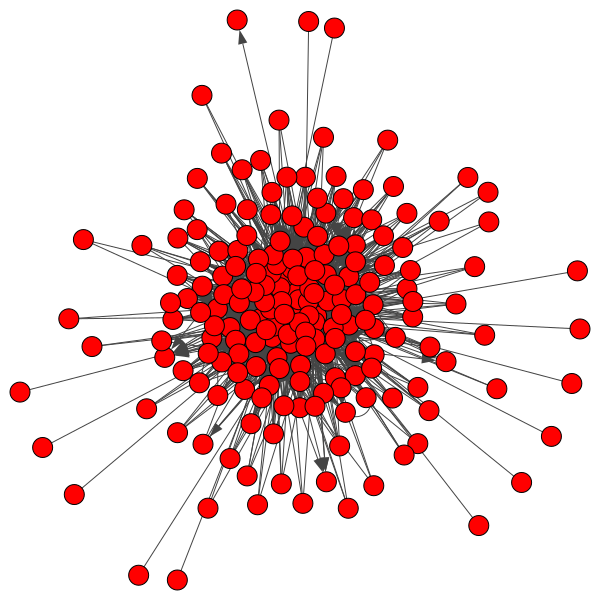

In [14]:
ig.plot(g)

In [15]:
g.diameter()

4

In [16]:
print( "Clustering Coefficient: ", g.transitivity_undirected())

Clustering Coefficient:  0.3859593515919117


In [17]:
np.mean(g.degree())

28.979591836734695

In [18]:
np.mean(g.strength(weights = 'weight'))

5647.821428571428

In [19]:
df_strength = pd.DataFrame({'name': list(g.vs['name']), 'weighted_degree':g.strength(weights = 'weight') } )
df_strength = df_strength.sort_values('weighted_degree', ascending = False).reset_index(drop = True)
df_strength

,name,weighted_degree
0,British Virgin Islands,287863.5
1,Hong Kong,113074.5
2,Panama,109901.0
3,Switzerland,77214.5
4,Bahamas,40701.5
...,...,...
191,Bhutan,2.0
192,Yemen,2.0
193,Palestine,2.0
194,Northern Mariana Islands,1.5


In [20]:
df_indegree = pd.DataFrame({'name': list(g.vs['name']), 'weighted_indegree':g.strength(weights = 'weight', mode = 'in') } )
df_indegree = df_indegree.sort_values('weighted_indegree', ascending = False).reset_index(drop = True)
df_indegree

,name,weighted_indegree
0,British Virgin Islands,280925.0
1,Panama,89885.0
2,Seychelles,31501.5
3,Bahamas,31085.0
4,Niue,18912.0
...,...,...
191,Finland,0.0
192,Fiji,0.0
193,El Salvador,0.0
194,Egypt,0.0


In [21]:
df_outdegree = pd.DataFrame({'name': list(g.vs['name']), 'weighted_outdegree':g.strength(weights = 'weight', mode = 'out') } )
df_outdegree = df_outdegree.sort_values('weighted_outdegree', ascending = False).reset_index(drop = True)
df_outdegree

,name,weighted_outdegree
0,Hong Kong,98929.5
1,Switzerland,76988.5
2,Taiwan,34922.5
3,Jersey,29443.5
4,China,22683.0
...,...,...
191,Netherlands Antilles,0.0
192,Dubai,0.0
193,Labuan,0.0
194,Nevada,0.0


## Metrics

In [22]:
def get_diameter(community):
    
    diameters = []
    
    for i in range(len(community.subgraphs())):
    
        diameters.append(community.subgraphs()[i].diameter())

    return (diameters)

In [23]:
def get_transitivity(community):
    
    transitivity = []
    
    for i in range(len(community.subgraphs())):
    
        transitivity.append(community.subgraphs()[i].transitivity_undirected())

    return (transitivity)

In [24]:
def get_avg_degree(community):
    
    degree = []
    
    for i in range(len(community.subgraphs())):
    
        degree.append(np.mean(community.subgraphs()[i].degree()))

    return degree

In [25]:
def get_avg_weighted_degree(community):
    
    weighted_degree = []
    
    for i in range(len(community.subgraphs())):
    
        weighted_degree.append(np.mean(community.subgraphs()[i].strength(weights = 'weight')))

    return weighted_degree

## Community Detection

In [26]:
# Define colors used for visualization
colors = ['blue', 'yellow', 'green','purple', 'pink', 'orange', 'lightcoral', 'plum', 'darkgreen', 'darkblue', 'rosybrown',
         'crimson', 'steelblue', 'khaki', 'moccasin', 'orangered', 'fuchsia', 'thistle', 'salmon', 'chocolate', 'lightseagreen',
         'springgreen', 'darkseagreen', 'deeppink', 'mediumvioletred','olive']

### Label Propogation Community Detection

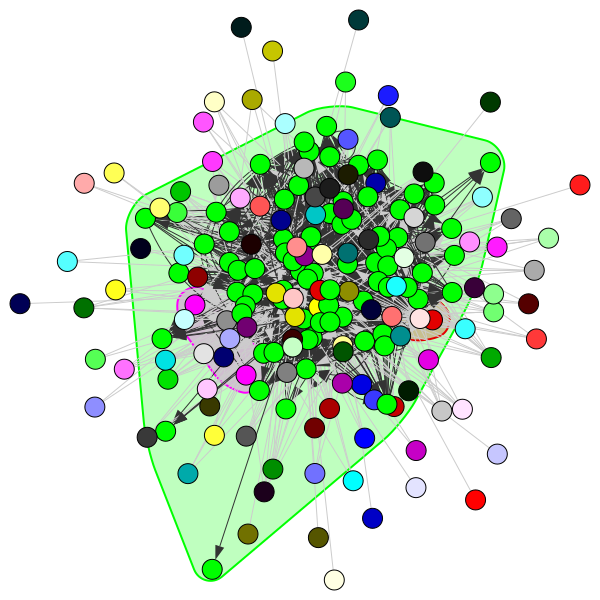

In [27]:
comm_lp= g.community_label_propagation(weights = 'weight')

ig.plot(comm_lp, mark_groups = True, layout="drl")

In [28]:
modularity = g.modularity(comm_lp, weights='weight')
print(modularity)

0.0012263425368253737


In [29]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_lp))
print('average degree: ', get_avg_degree(comm_lp))
print('transitivity: ', get_transitivity(comm_lp))
print('diameter: ', get_diameter(comm_lp))

average weighted degree:  [0.0, 13304.311688311689, 0.0, 0.0, 84.0, 0.0, 0.0, 18.0, 0.0, 0.0, 230.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 46.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

### Leading Eigenvector Community Detection

/Users/susankoruthu/opt/anaconda3/lib/python3.8/site-packages/igraph/__init__.py:1281: RuntimeWarning: This method was developed for undirected graphs at src/community/leading_eigenvector.c:530
  membership, _, q = GraphBase.community_leading_eigenvector(


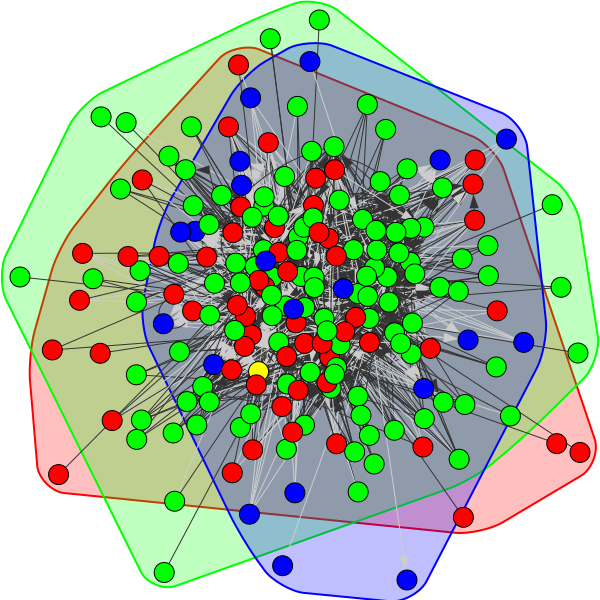

In [30]:
comm_leading_eigenvector= g.community_leading_eigenvector(weights = 'weight')

ig.plot(comm_leading_eigenvector, mark_groups = True, layout="drl")

In [31]:
modularity = g.modularity(comm_leading_eigenvector, weights='weight')
print(modularity)

0.1503749727369289


In [32]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_leading_eigenvector))
print('average degree: ', get_avg_degree(comm_leading_eigenvector))
print('transitivity: ', get_transitivity(comm_leading_eigenvector))
print('diameter: ', get_diameter(comm_leading_eigenvector))

average weighted degree:  [3447.0862068965516, 4977.735042735043, 0.85, 0.0]
average degree:  [8.172413793103448, 24.666666666666668, 0.2, 0.0]
transitivity:  [0.2783573806881243, 0.45566413318856314, nan, nan]
diameter:  [3, 3, 1, 0]


In [33]:
df_leading_eigenvector = pd.DataFrame({'name': list(g.vs['name']), 'community':comm_leading_eigenvector.membership } )
df_leading_eigenvector

,name,community
0,Albania,0
1,Bahamas,0
2,Algeria,1
3,British Virgin Islands,1
4,United Kingdom,1
...,...,...
191,Venezuela,0
192,Vietnam,1
193,Yemen,0
194,Zambia,1


In [34]:
df_leading_eigenvector.describe()

,community
count,196.000000
mean,0.816327
std,0.621775
min,0.000000
25%,0.000000
50%,1.000000
75%,1.000000
max,3.000000


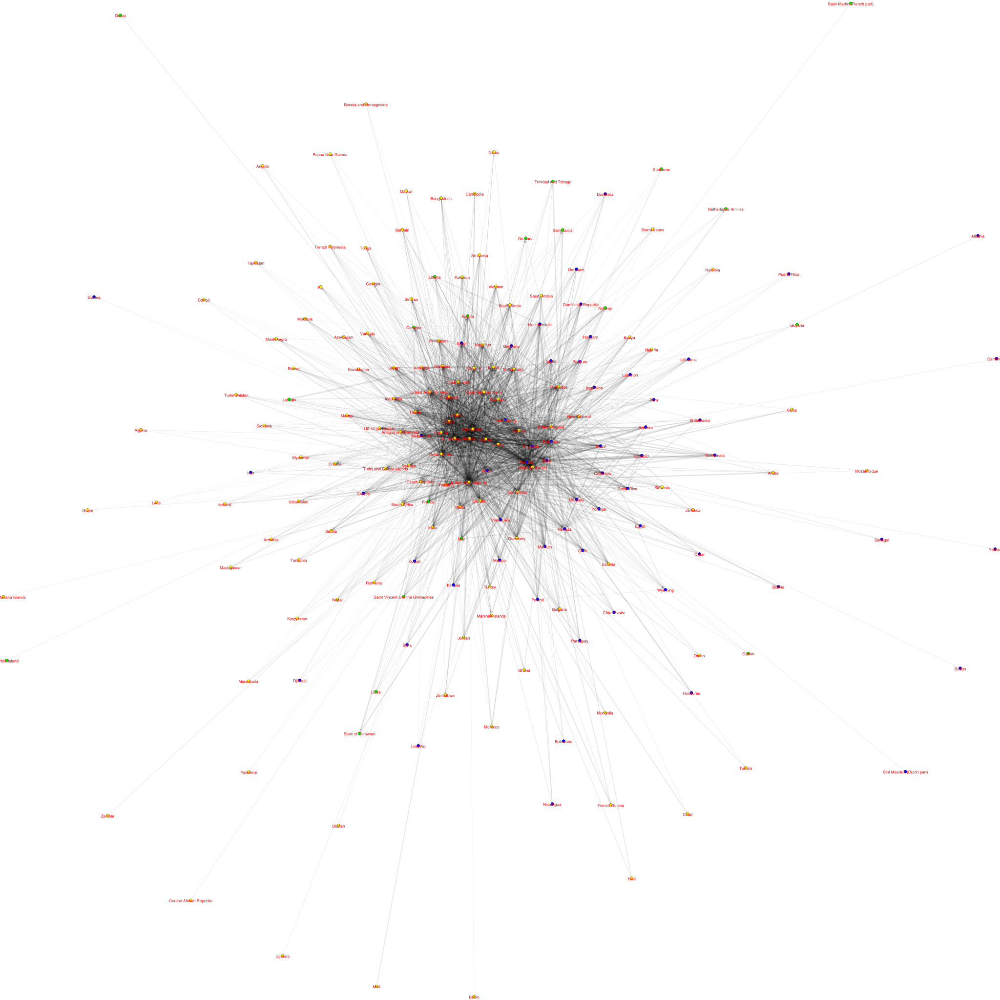

In [35]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_leading_eigenvector.membership)):
    vertex_colors.append(colors[comm_leading_eigenvector.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g,'directed_images/communities_leading_eigenvector.png', vertex_label = g.vs['name'] , **visual_style)

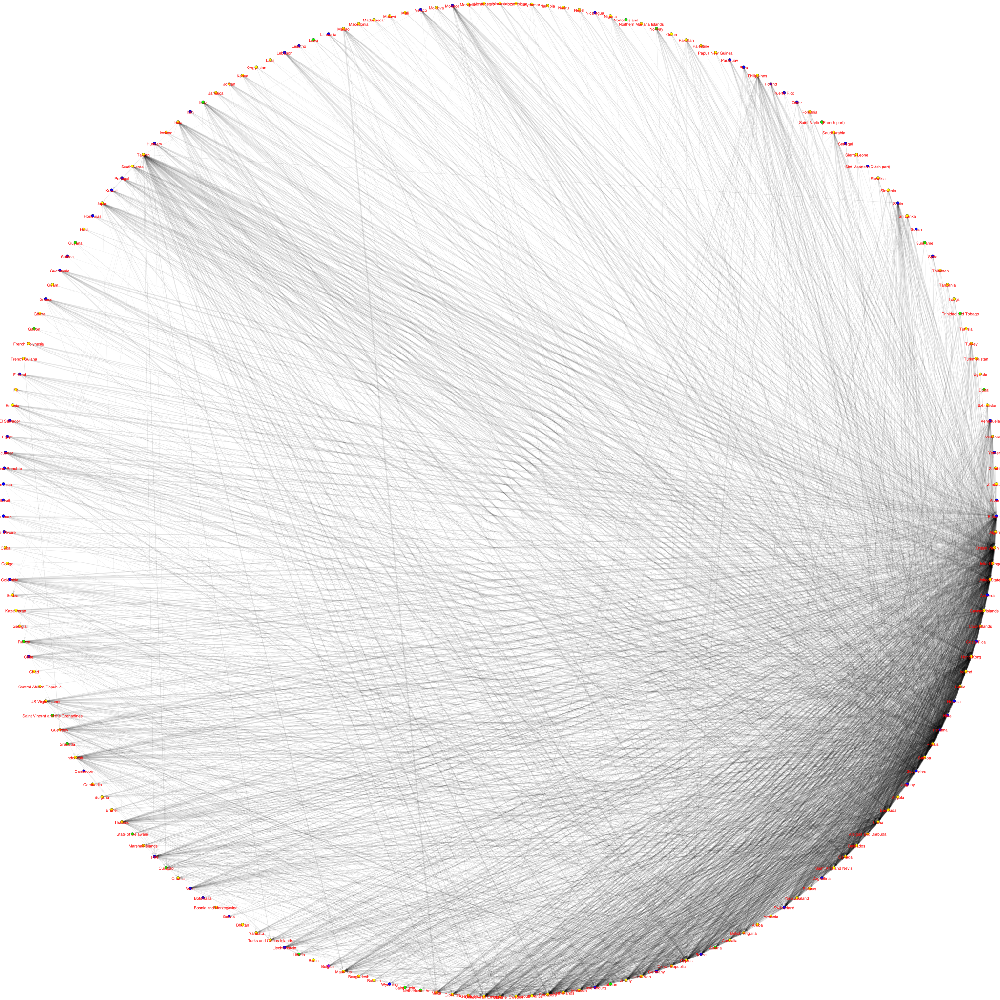

In [36]:
# Set the layout
my_layout = g.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g,'directed_images/leading_vector_circular.png', vertex_label = g.vs['name'] , **visual_style)

In [37]:
for i in range(len(comm_leading_eigenvector.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_leading_eigenvector.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_leading_eigenvector.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_leading_eigenvector.subgraphs()[i],'directed_images/leading_eigenvector_subgraph' + str(i) + '.png' ,vertex_label = comm_leading_eigenvector.subgraphs()[i].vs['name'],**visual_style  )
    

### Spinglass Community Detection

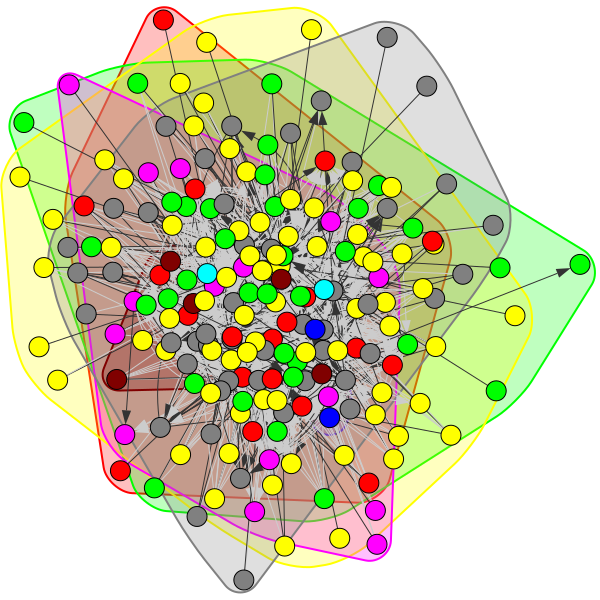

In [38]:
comm_spinglass = g.community_spinglass(weights = 'weight')

ig.plot(comm_spinglass, mark_groups = True, layout="drl")

In [39]:
modularity = g.modularity(comm_spinglass, weights='weight')
print(modularity)

0.05390683849323257


In [40]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_spinglass))
print('average degree: ', get_avg_degree(comm_spinglass))
print('transitivity: ', get_transitivity(comm_spinglass))
print('diameter: ', get_diameter(comm_spinglass))

average weighted degree:  [1465.2631578947369, 2071.3529411764707, 230.0, 1129.718309859155, 118.26666666666667, 845.0, 2390.4166666666665, 313.6]
average degree:  [4.947368421052632, 3.823529411764706, 1.0, 3.5211267605633805, 2.4, 1.0, 15.166666666666666, 2.0]
transitivity:  [0.39, 0.1836734693877551, nan, 0.06147127981189116, 0.1111111111111111, nan, 0.5773672055427251, 0.0]
diameter:  [3, 4, 1, 3, 3, 1, 3, 1]


In [41]:
df_spinglass = pd.DataFrame({'name': list(g.vs['name']), 'community':comm_spinglass.membership } )
df_spinglass

,name,community
0,Albania,0
1,Bahamas,0
2,Algeria,6
3,British Virgin Islands,3
4,United Kingdom,6
...,...,...
191,Venezuela,1
192,Vietnam,6
193,Yemen,1
194,Zambia,3


In [42]:
df_spinglass.describe()

,community
count,196.000000
mean,3.285714
std,2.060620
min,0.000000
25%,1.000000
50%,3.000000
75%,6.000000
max,7.000000


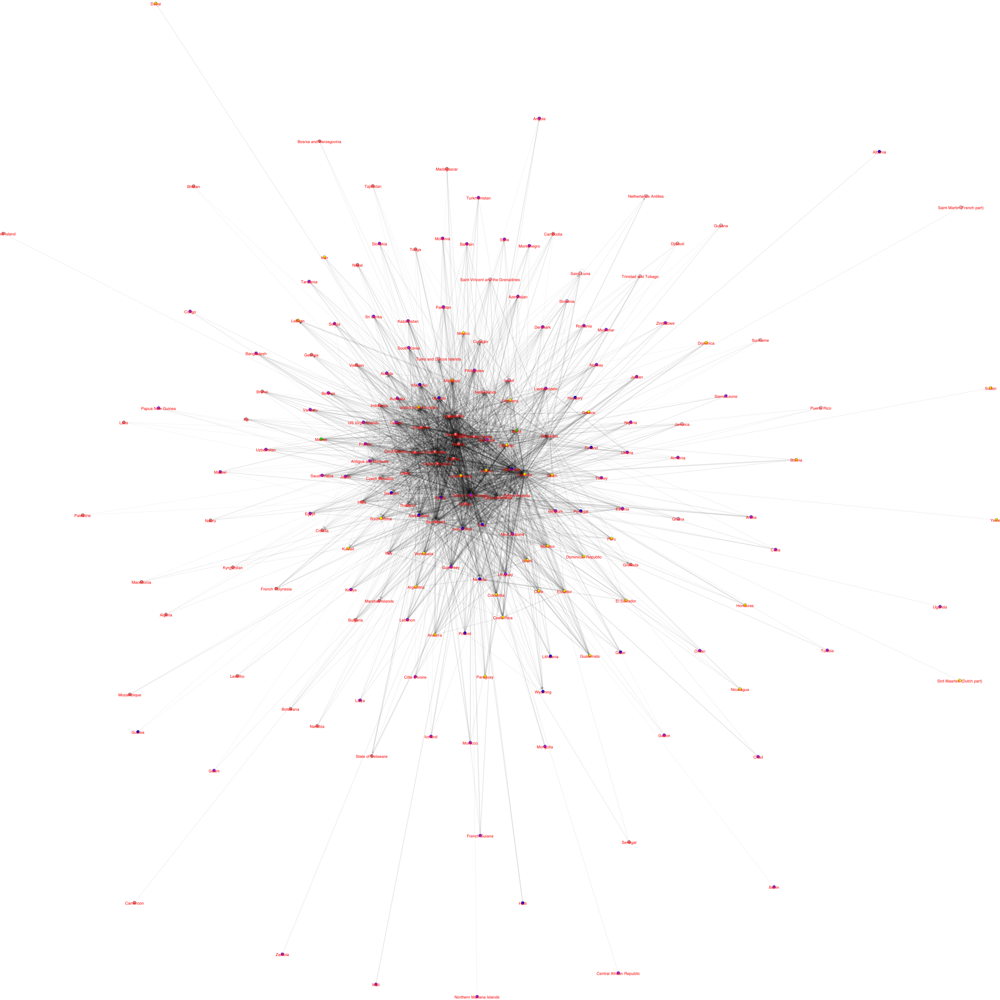

In [43]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_spinglass.membership)):
    vertex_colors.append(colors[comm_spinglass.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g,'directed_images/communities_spinglass.png', vertex_label = g.vs['name'] , **visual_style)

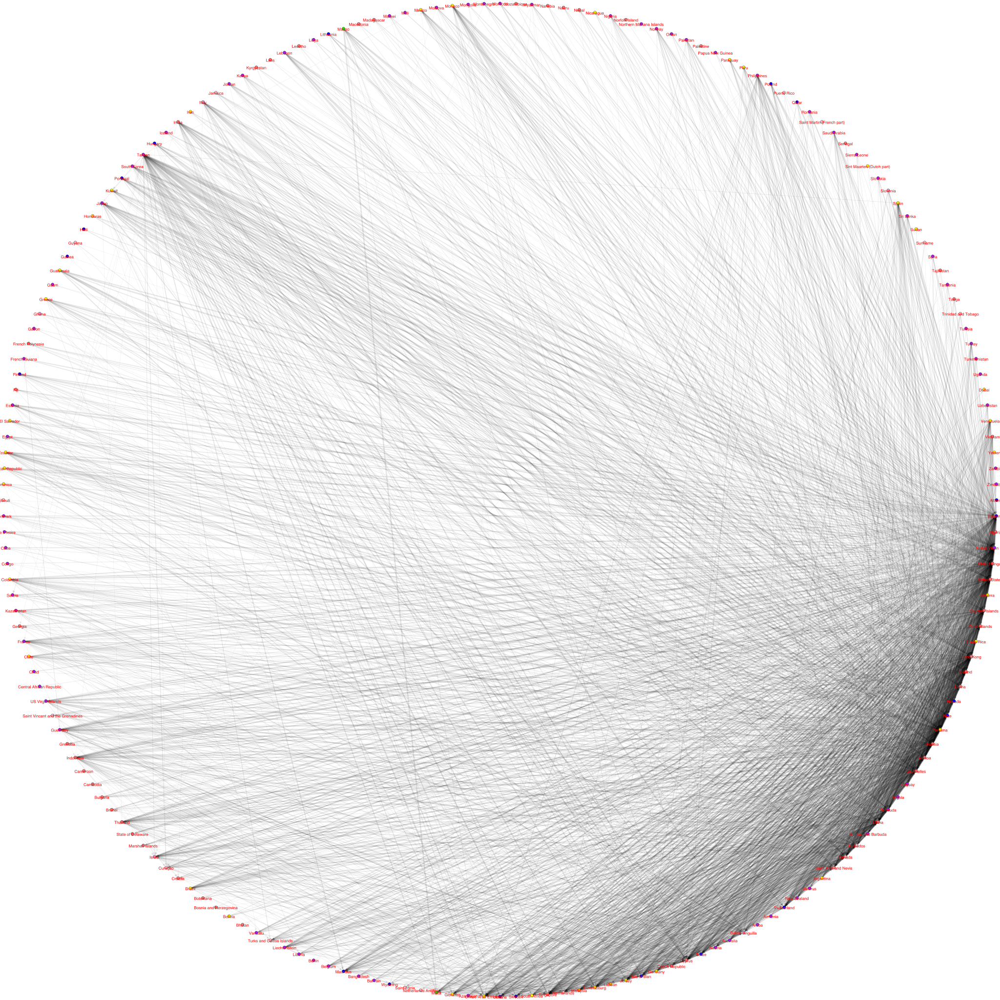

In [44]:
# Set the layout
my_layout = g.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g,'directed_images/spinglass_circular.png', vertex_label = g.vs['name'] , **visual_style)

In [45]:
for i in range(len(comm_spinglass.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_spinglass.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_spinglass.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_spinglass.subgraphs()[i],'directed_images/spinglass_subgraph' + str(i) + '.png' ,vertex_label = comm_spinglass.subgraphs()[i].vs['name'],**visual_style  )
    

### Walktrap Community Detection

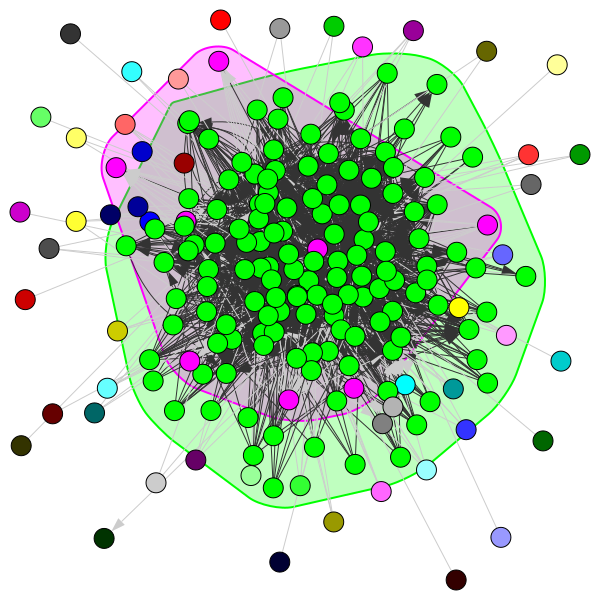

In [46]:
walktrap = g.community_walktrap(weights = 'weight', steps = 2)

comm_walktrap = walktrap.as_clustering()

ig.plot(comm_walktrap, mark_groups = True, layout="drl")

In [47]:
modularity = g.modularity(comm_walktrap, weights='weight')
print(modularity)

0.002050025384918412


In [48]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_walktrap))
print('average degree: ', get_avg_degree(comm_walktrap))
print('transitivity: ', get_transitivity(comm_walktrap))
print('diameter: ', get_diameter(comm_walktrap))

average weighted degree:  [0.0, 7984.430656934306, 0.0, 0.0, 143.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 36.90510948905109, 0.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
transitivity:  [nan, 0.44463040899562895, nan, nan, 0.0, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]
diameter:  [0, 4, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [49]:
df_walktrap = pd.DataFrame({'name': list(g.vs['name']), 'community':comm_walktrap.membership } )
df_walktrap

,name,community
0,Albania,0
1,Bahamas,1
2,Algeria,2
3,British Virgin Islands,1
4,United Kingdom,1
...,...,...
191,Venezuela,1
192,Vietnam,1
193,Yemen,51
194,Zambia,52


In [50]:
df_walktrap.describe()

,community
count,196.000000
mean,7.867347
std,13.652566
min,0.000000
25%,1.000000
50%,1.000000
75%,4.000000
max,52.000000


In [51]:
# ##plot community
# visual_style = {}

# vertex_colors = []

# for i in range(len(comm_walktrap.membership)):
#     vertex_colors.append(colors[comm_walktrap.membership[i]])
    
# # Set bbox and margin
# visual_style["bbox"] = (5000,5000)
# visual_style["margin"] = 17

# # Set vertex colours
# visual_style["vertex_color"] = vertex_colors

# # Set edge width
# visual_style["edge_width"] = np.log(g.es['weight']) + 1

# # Set edge color
# visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# # Set vertex size
# visual_style["vertex_size"] = 15

# # Set vertex label size
# visual_style["vertex_label_size"] = 20

# # Set vertex label color
# visual_style["vertex_label_color"] = 'red'

# # Don't curve the edges
# visual_style["edge_curved"] = False

# # Set the layout
# my_layout = g.layout_fruchterman_reingold()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g,'directed_images/communities_walktrap.png', vertex_label = g.vs['name'] , **visual_style)

In [52]:
# # Set the layout
# my_layout = g.layout_circle()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g,'directed_images/walktrap_circular.png', vertex_label = g.vs['name'] , **visual_style)

In [53]:
# for i in range(len(comm_walktrap.subgraphs())):
    
#     visual_style["bbox"] = (2000,2000)
#     visual_style["margin"] = 17
    
#     # Set vertex colours
#     visual_style["vertex_color"] = 'green'

#     # Set edge width
#     visual_style["edge_width"] = np.log(comm_walktrap.subgraphs()[i].es['weight']) + 1
#     # Set the layout
#     my_layout = comm_walktrap.subgraphs()[i].layout_fruchterman_reingold()
#     visual_style["layout"] = my_layout

#     ig.plot(comm_walktrap.subgraphs()[i],'directed_images/walktrap_subgraph' + str(i) + '.png' ,vertex_label = comm_walktrap.subgraphs()[i].vs['name'],**visual_style  )
    

### Infomap Community Detection

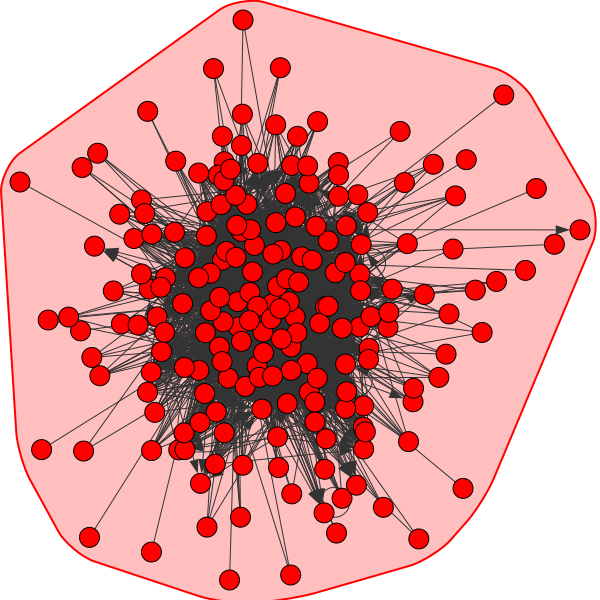

In [54]:
comm_infomap = g.community_infomap(edge_weights = 'weight')

ig.plot(comm_infomap, mark_groups = True, layout="drl")

In [55]:
modularity = g.modularity(comm_infomap, weights='weight')
print(modularity)

0.0


In [56]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_infomap))
print('average degree: ', get_avg_degree(comm_infomap))
print('transitivity: ', get_transitivity(comm_infomap))
print('diameter: ', get_diameter(comm_infomap))

average weighted degree:  [5647.821428571428]
average degree:  [28.979591836734695]
transitivity:  [0.3859593515919117]
diameter:  [4]


In [57]:
df_infomap = pd.DataFrame({'name': list(g.vs['name']), 'community':comm_infomap.membership } )
df_infomap

,name,community
0,Albania,0
1,Bahamas,0
2,Algeria,0
3,British Virgin Islands,0
4,United Kingdom,0
...,...,...
191,Venezuela,0
192,Vietnam,0
193,Yemen,0
194,Zambia,0


# All Jurisdictions

In [58]:
df_weighted['status'].unique()

array(['jurisdiction', 'intermediary_base', 'intermediary_jurisdiction',
       'officer_base', 'officer_jurisdiction'], dtype=object)

In [59]:
jurisdiction_list = ['jurisdiction', 'officer_jurisdiction','intermediary jurisdiction']

In [60]:
df_weighted_jur = df_weighted[df_weighted['status'].isin(jurisdiction_list)]
df_jur = df_weighted_jur.drop(['status'], axis = 1)
df_jur

,node_start,node_end,weight
0,Hong Kong,Samoa,2.0
1,Hong Kong,Samoa,2.0
2,Hong Kong,Samoa,2.0
3,Hong Kong,Samoa,2.0
4,Hong Kong,Samoa,2.0
...,...,...,...
221136,Indonesia,Samoa,0.5
221137,Cayman Islands,Samoa,0.5
221138,British Virgin Islands,Samoa,0.5
221139,China,Samoa,0.5


In [61]:
df_jur_grouped = df_jur.groupby(['node_start','node_end'], as_index = False).sum()
df_jur_grouped

,node_start,node_end,weight
0,Albania,Bahamas,4.0
1,Andorra,Bahamas,52.0
2,Andorra,British Virgin Islands,78.0
3,Andorra,Cayman Islands,2.0
4,Andorra,Costa Rica,6.0
...,...,...,...
1222,Vietnam,Panama,2.0
1223,Yemen,Panama,2.0
1224,Zambia,British Virgin Islands,4.0
1225,Zimbabwe,British Virgin Islands,10.0


### Convert Data to an Undirected Edge List

In [62]:
# df_jur_grouped_list = df_jur_grouped.values.tolist()
# df_jur_grouped_list

In [63]:
# d = collections.defaultdict(int)
# for n1, n2, v in df_jur_grouped_list:
#     d[min(n1, n2), max(n1, n2)] += v
# result = [[k[0], k[1], v] for k, v in d.items()]

In [64]:
# df_net = pd.DataFrame(result)
# df_net

In [65]:
# df_net = df_net.rename(columns = {0:'node_1', 1:'node_2', 2: 'weight'})
# df_net

In [66]:
#df_net.to_csv('undirected_weighted_grouped.csv', index = False)

In [67]:
# df_net.describe()

## Create Graph

In [68]:
g_aj = ig.Graph.TupleList(df_jur_grouped.itertuples(index=False), directed=True, edge_attrs={'weight': "weight"})


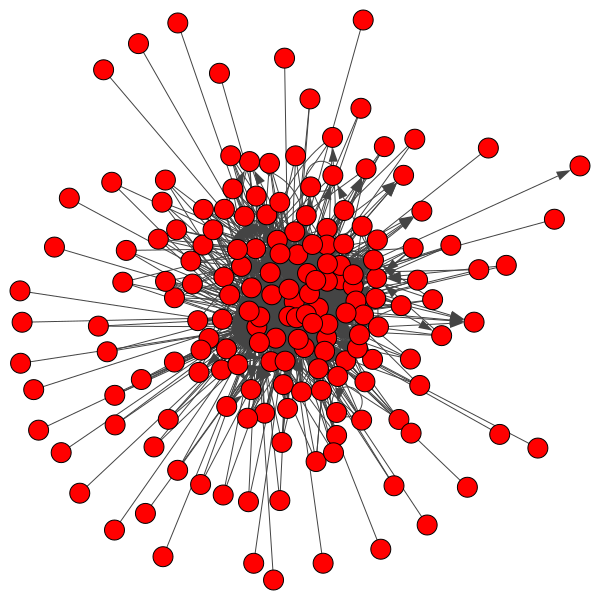

In [69]:
ig.plot(g_aj)

In [70]:
g_aj.diameter()

5

In [71]:
print( "Clustering Coefficient: ", g_aj.transitivity_undirected())

Clustering Coefficient:  0.24745484400656814


In [72]:
np.mean(g_aj.degree())

14.10344827586207

In [73]:
np.mean(g_aj.strength(weights = 'weight'))

4979.028735632184

In [74]:
df_strength = pd.DataFrame({'name': list(g_aj.vs['name']), 'weighted_degree':g_aj.strength(weights = 'weight') } )
df_strength = df_strength.sort_values('weighted_degree', ascending = False).reset_index(drop = True)
df_strength

,name,weighted_degree
0,British Virgin Islands,232588.5
1,Panama,104014.0
2,Hong Kong,78953.0
3,Switzerland,76304.0
4,Bahamas,40402.0
...,...,...
169,Malawi,2.0
170,Georgia,2.0
171,Yemen,2.0
172,Nauru,2.0


## Community Detection

### Label Propogation Community Detection

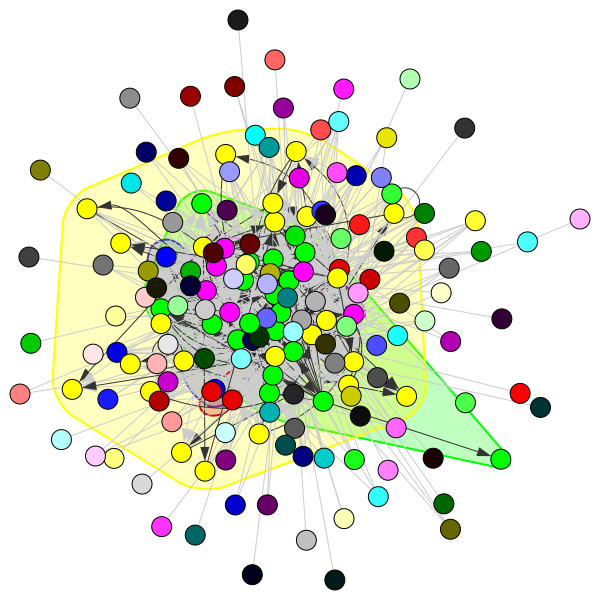

In [75]:
comm_lp_aj= g_aj.community_label_propagation(weights = 'weight')

ig.plot(comm_lp_aj, mark_groups = True, layout="drl")

In [76]:
modularity = g_aj.modularity(comm_lp_aj, weights='weight')
print(modularity)

0.018752937762561345


In [77]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_lp_aj))
print('average degree: ', get_avg_degree(comm_lp_aj))
print('transitivity: ', get_transitivity(comm_lp_aj))
print('diameter: ', get_diameter(comm_lp_aj))

average weighted degree:  [0.0, 24124.38888888889, 30.0, 448.1304347826087, 194.0, 0.0, 0.0, 165.33333333333334, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 16.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 14.88888888888889, 1.0, 6.0, 5.0, 0.0, 0.0, 1.3333333333333333, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

### Leading Eigenvector Community Detection

/Users/susankoruthu/opt/anaconda3/lib/python3.8/site-packages/igraph/__init__.py:1281: RuntimeWarning: This method was developed for undirected graphs at src/community/leading_eigenvector.c:530
  membership, _, q = GraphBase.community_leading_eigenvector(


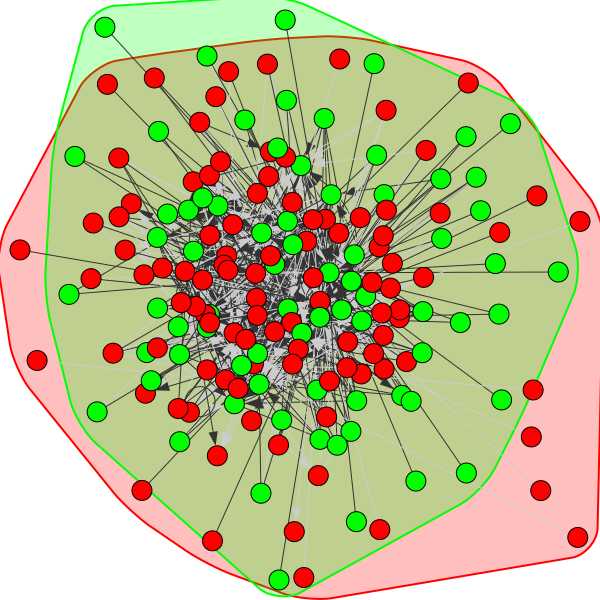

In [78]:
comm_leading_eigenvector_aj= g_aj.community_leading_eigenvector(weights = 'weight')

ig.plot(comm_leading_eigenvector_aj, mark_groups = True, layout="drl")

In [79]:
modularity = g_aj.modularity(comm_leading_eigenvector_aj, weights='weight')
print(modularity)

0.1392852852192658


In [80]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_leading_eigenvector_aj))
print('average degree: ', get_avg_degree(comm_leading_eigenvector_aj))
print('transitivity: ', get_transitivity(comm_leading_eigenvector_aj))
print('diameter: ', get_diameter(comm_leading_eigenvector_aj))

average weighted degree:  [1810.1782178217823, 5338.041095890411]
average degree:  [5.326732673267327, 9.643835616438356]
transitivity:  [0.1493288590604027, 0.3371588523442967]
diameter:  [3, 4]


In [81]:
df_leading_eigenvector_aj= pd.DataFrame({'name': list(g_aj.vs['name']), 'community':comm_leading_eigenvector_aj.membership } )
df_leading_eigenvector_aj

,name,community
0,Albania,0
1,Bahamas,0
2,Andorra,0
3,British Virgin Islands,1
4,Cayman Islands,1
...,...,...
169,Venezuela,0
170,Vietnam,1
171,Yemen,0
172,Zambia,1


In [82]:
df_leading_eigenvector_aj.describe()

,community
count,174.000000
mean,0.419540
std,0.494908
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


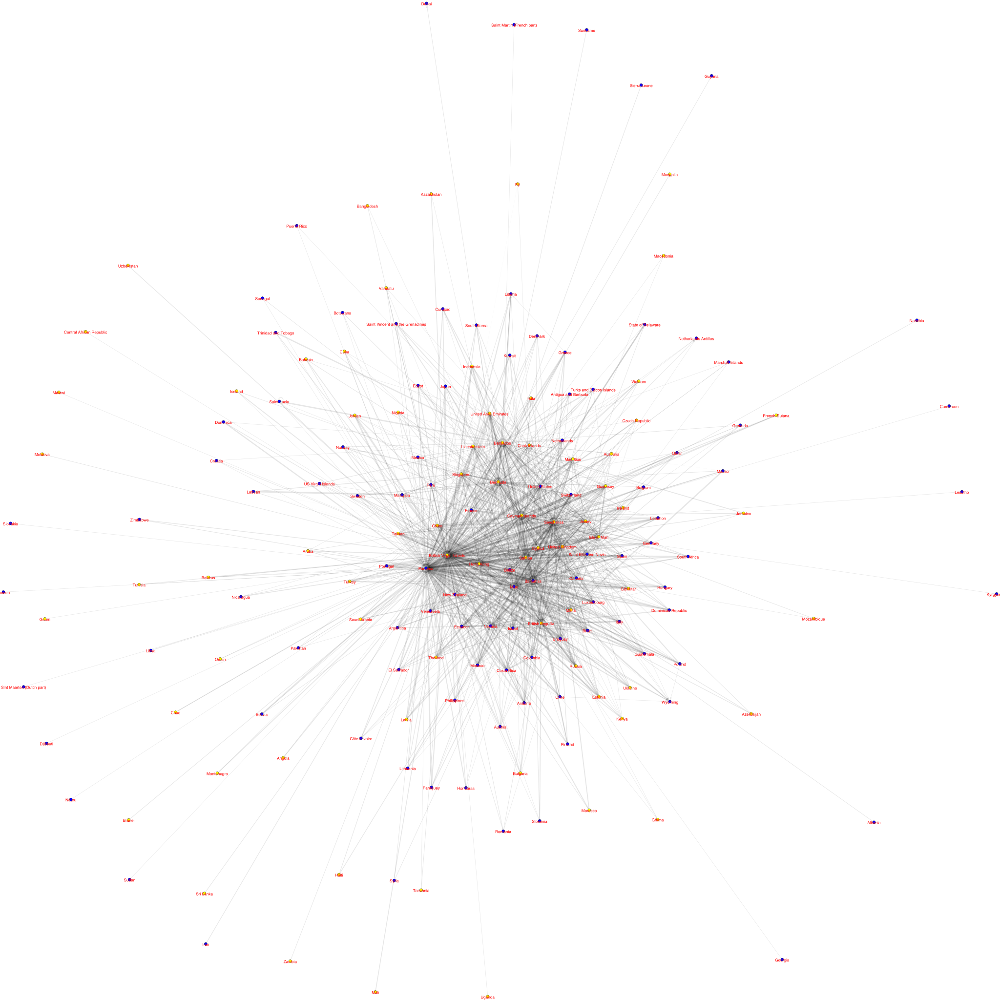

In [83]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_leading_eigenvector_aj.membership)):
    vertex_colors.append(colors[comm_leading_eigenvector_aj.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_aj.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_aj.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_aj,'directed_all_jur_images/communities_leading_eigenvector.png', vertex_label = g_aj.vs['name'] , **visual_style)

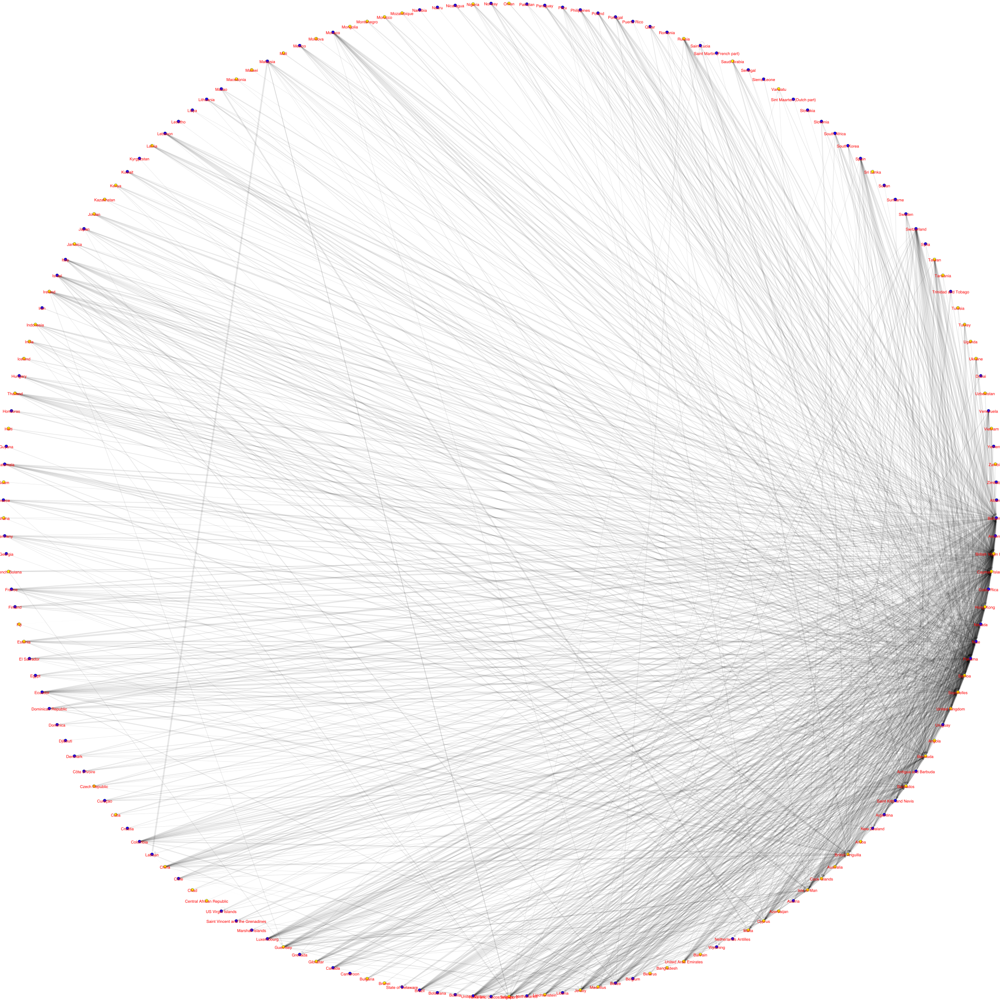

In [84]:
# Set the layout
my_layout = g_aj.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_aj,'directed_all_jur_images/leading_vector_circular.png', vertex_label = g_aj.vs['name'] , **visual_style)

In [85]:
for i in range(len(comm_leading_eigenvector_aj.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_leading_eigenvector_aj.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_leading_eigenvector_aj.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_leading_eigenvector_aj.subgraphs()[i],'directed_all_jur_images/leading_eigenvector_subgraph' + str(i) + '.png' ,vertex_label = comm_leading_eigenvector_aj.subgraphs()[i].vs['name'],**visual_style  )
    

### Spinglass Community Detection

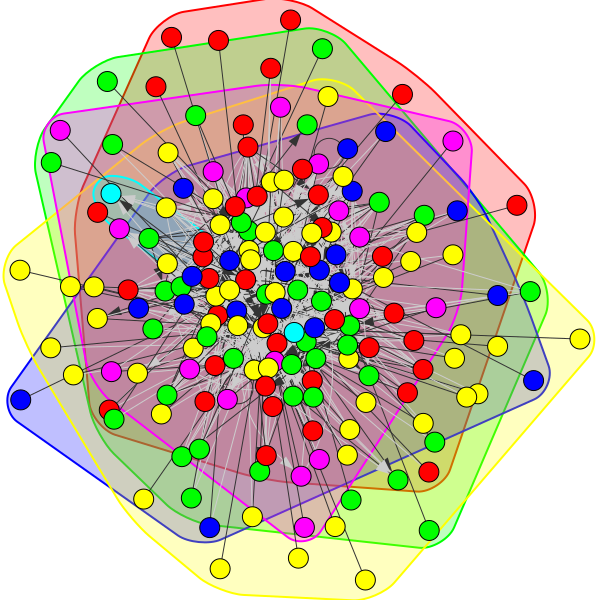

In [86]:
comm_spinglass_aj = g_aj.community_spinglass(weights = 'weight')

ig.plot(comm_spinglass_aj, mark_groups = True, layout="drl")

In [87]:
modularity = g_aj.modularity(comm_spinglass_aj, weights='weight')
print(modularity)

0.13569283780013383


In [88]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_spinglass_aj))
print('average degree: ', get_avg_degree(comm_spinglass_aj))
print('transitivity: ', get_transitivity(comm_spinglass_aj))
print('diameter: ', get_diameter(comm_spinglass_aj))

average weighted degree:  [3140.0, 1567.4871794871794, 659.0, 2847.6545454545453, 105.11111111111111, 844.0]
average degree:  [3.7, 5.384615384615385, 2.5, 3.4909090909090907, 2.111111111111111, 1.0]
transitivity:  [0.12274024738344434, 0.30280373831775703, 0.11392405063291139, 0.09441805225653206, 0.0, nan]
diameter:  [2, 4, 3, 6, 1, 1]


In [89]:
df_spinglass_aj = pd.DataFrame({'name': list(g_aj.vs['name']), 'community':comm_spinglass_aj.membership } )
df_spinglass_aj

,name,community
0,Albania,2
1,Bahamas,2
2,Andorra,0
3,British Virgin Islands,3
4,Cayman Islands,1
...,...,...
169,Venezuela,0
170,Vietnam,1
171,Yemen,0
172,Zambia,3


In [90]:
df_spinglass_aj.describe()

,community
count,174.000000
mean,1.873563
std,1.404408
min,0.000000
25%,1.000000
50%,2.000000
75%,3.000000
max,5.000000


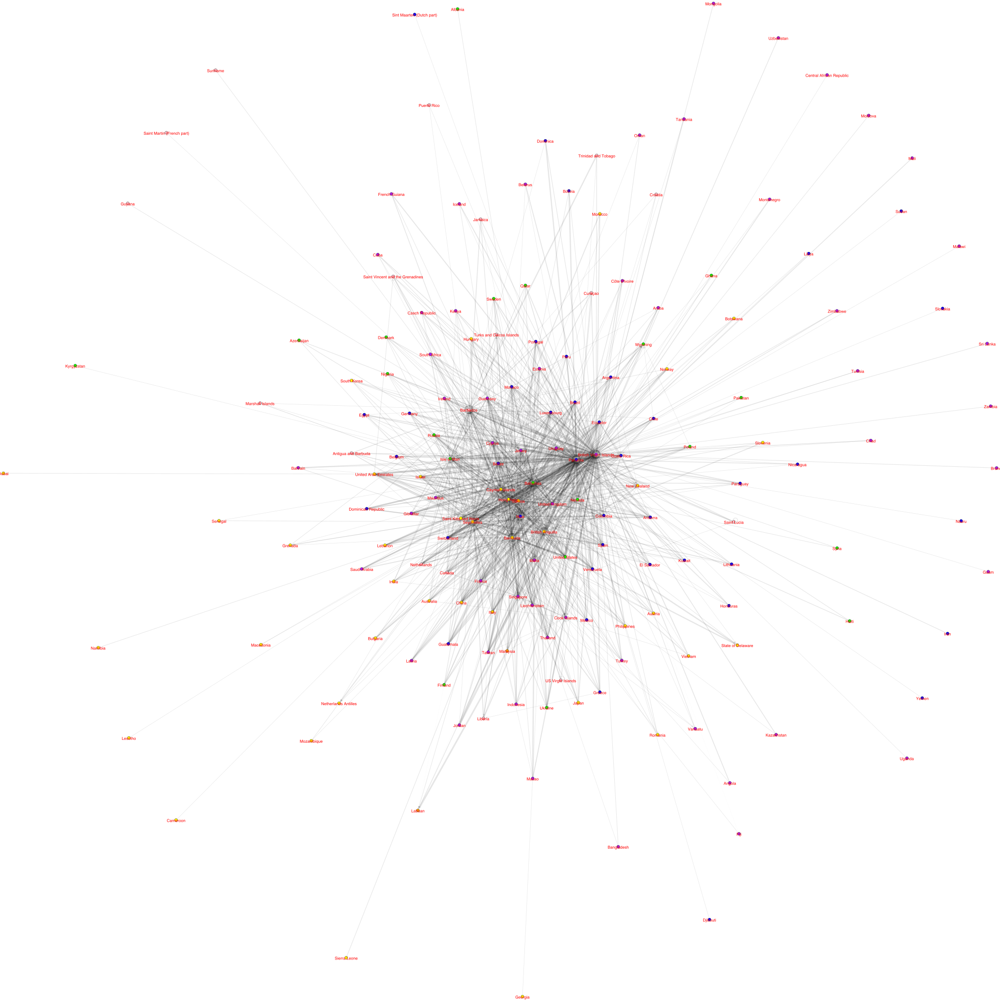

In [91]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_spinglass_aj.membership)):
    vertex_colors.append(colors[comm_spinglass_aj.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_aj.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_aj.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_aj,'directed_all_jur_images/communities_spinglass.png', vertex_label = g_aj.vs['name'] , **visual_style)

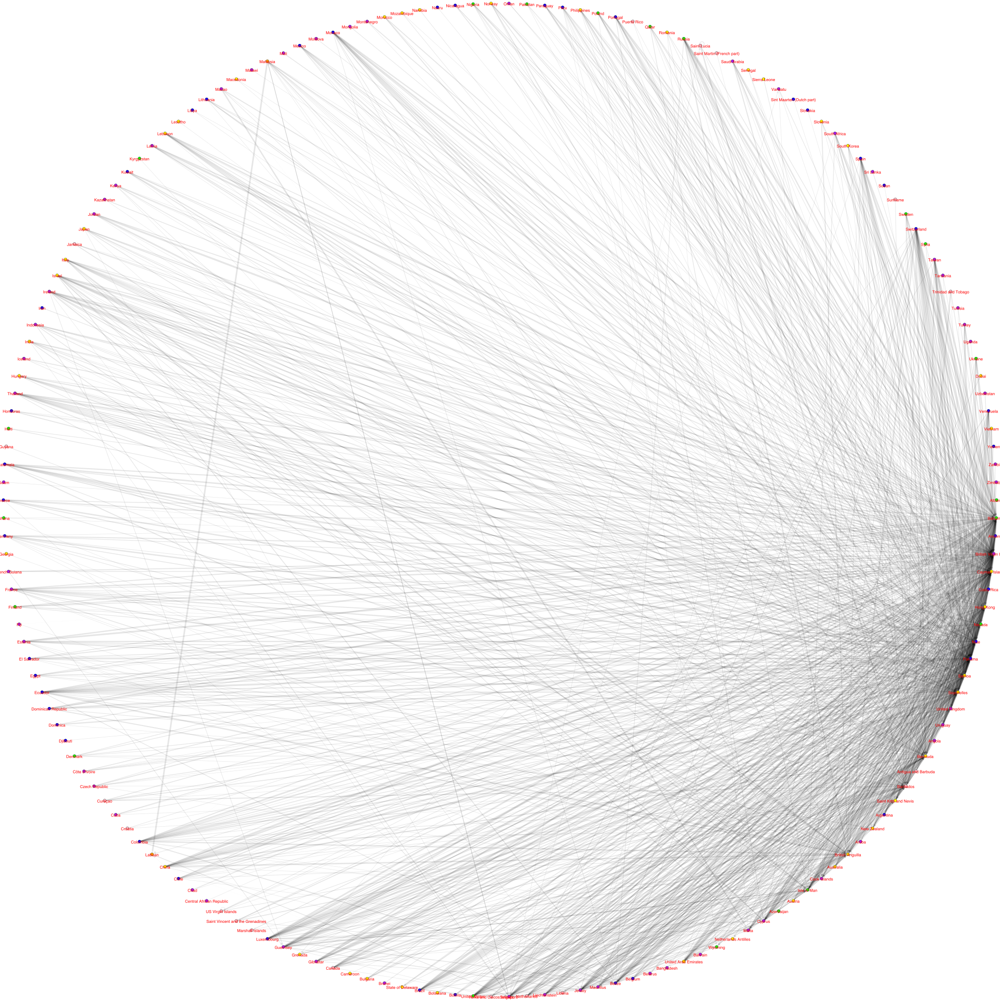

In [92]:
# Set the layout
my_layout = g_aj.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_aj,'directed_all_jur_images/spinglass_circular.png', vertex_label = g_aj.vs['name'] , **visual_style)

In [93]:
for i in range(len(comm_spinglass_aj.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_spinglass_aj.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_spinglass_aj.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_spinglass_aj.subgraphs()[i],'directed_all_jur_images/spinglass_subgraph' + str(i) + '.png' ,vertex_label = comm_spinglass_aj.subgraphs()[i].vs['name'],**visual_style  )
    

### Walktrap Community Detection

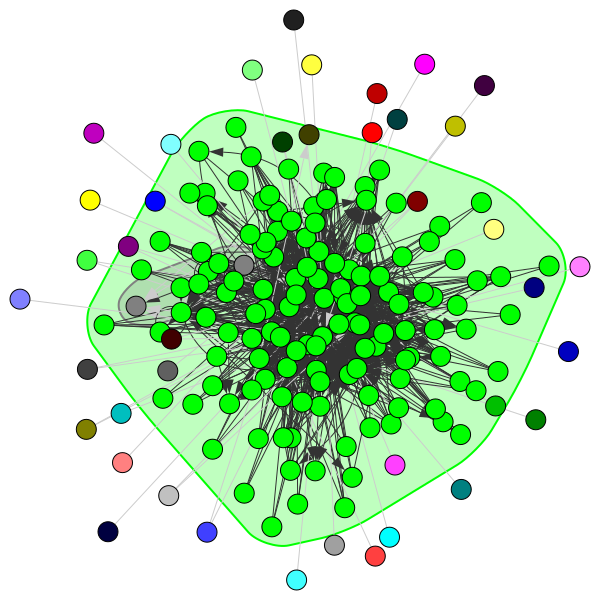

In [94]:
walktrap_aj = g_aj.community_walktrap(weights = 'weight', steps = 2)

comm_walktrap_aj = walktrap_aj.as_clustering()

ig.plot(comm_walktrap_aj, mark_groups = True, layout="drl")

In [95]:
modularity = g_aj.modularity(comm_walktrap_aj, weights='weight')
print(modularity)

0.003886750362990465


In [96]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_walktrap_aj))
print('average degree: ', get_avg_degree(comm_walktrap_aj))
print('transitivity: ', get_transitivity(comm_walktrap_aj))
print('diameter: ', get_diameter(comm_walktrap_aj))

average weighted degree:  [0.0, 6545.106060606061, 0.0, 0.0, 0.0, 0.0, 844.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 17.545454545454547, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
transitivity:  [nan, 0.27739790086251687, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]
diameter:  [0, 4, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [97]:
df_walktrap_aj = pd.DataFrame({'name': list(g_aj.vs['name']), 'community':comm_walktrap_aj.membership } )
df_walktrap_aj

,name,community
0,Albania,0
1,Bahamas,1
2,Andorra,1
3,British Virgin Islands,1
4,Cayman Islands,1
...,...,...
169,Venezuela,1
170,Vietnam,1
171,Yemen,40
172,Zambia,41


In [98]:
df_walktrap_aj.describe()

,community
count,174.000000
mean,5.735632
std,10.274791
min,0.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,41.000000


In [99]:
# ##plot community
# visual_style = {}

# vertex_colors = []

# for i in range(len(comm_walktrap_aj.membership)):
#     vertex_colors.append(colors[comm_walktrap_aj.membership[i]])
    
# # Set bbox and margin
# visual_style["bbox"] = (5000,5000)
# visual_style["margin"] = 17

# # Set vertex colours
# visual_style["vertex_color"] = vertex_colors

# # Set edge width
# visual_style["edge_width"] = np.log(g_aj.es['weight']) + 1

# # Set edge color
# visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# # Set vertex size
# visual_style["vertex_size"] = 15

# # Set vertex label size
# visual_style["vertex_label_size"] = 20

# # Set vertex label color
# visual_style["vertex_label_color"] = 'red'

# # Don't curve the edges
# visual_style["edge_curved"] = False

# # Set the layout
# my_layout = g_aj.layout_fruchterman_reingold()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_aj,'directed_all_jur_images/communities_walktrap.png', vertex_label = g_aj.vs['name'] , **visual_style)

In [100]:
# # Set the layout
# my_layout = g.layout_circle()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_aj,'directed_all_jur_images/walktrap_circular.png', vertex_label = g_aj.vs['name'] , **visual_style)

In [101]:
# for i in range(len(comm_walktrap_aj.subgraphs())):
    
#     visual_style["bbox"] = (2000,2000)
#     visual_style["margin"] = 17
    
#     # Set vertex colours
#     visual_style["vertex_color"] = 'green'

#     # Set edge width
#     visual_style["edge_width"] = np.log(comm_walktrap_aj.subgraphs()[i].es['weight']) + 1
#     # Set the layout
#     my_layout = comm_walktrap_aj.subgraphs()[i].layout_fruchterman_reingold()
#     visual_style["layout"] = my_layout

#     ig.plot(comm_walktrap_aj.subgraphs()[i],'directed_all_jur_images/walktrap_subgraph' + str(i) + '.png' ,vertex_label = comm_walktrap_aj.subgraphs()[i].vs['name'],**visual_style  )
    

### Infomap Community Detection

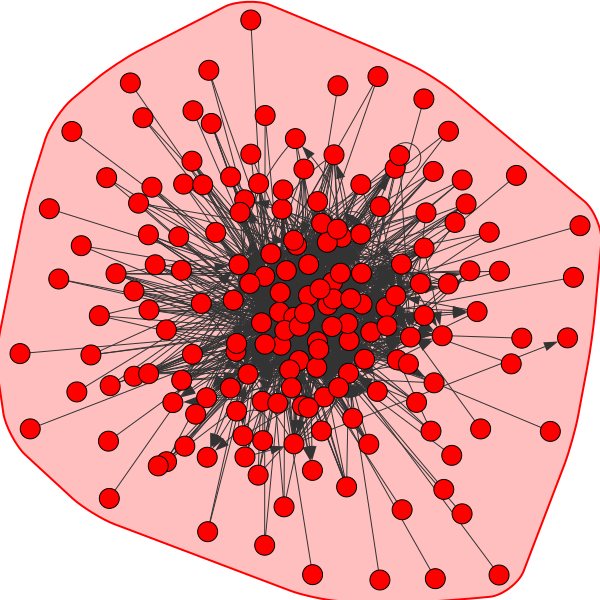

In [102]:
comm_infomap_aj = g_aj.community_infomap(edge_weights = 'weight')

ig.plot(comm_infomap_aj, mark_groups = True, layout="drl")

In [103]:
modularity = g_aj.modularity(comm_infomap_aj, weights='weight')
print(modularity)

0.0


In [104]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_infomap_aj))
print('average degree: ', get_avg_degree(comm_infomap_aj))
print('transitivity: ', get_transitivity(comm_infomap_aj))
print('diameter: ', get_diameter(comm_infomap_aj))

average weighted degree:  [4979.028735632184]
average degree:  [14.10344827586207]
transitivity:  [0.24745484400656814]
diameter:  [5]


In [105]:
df_infomap_aj = pd.DataFrame({'name': list(g_aj.vs['name']), 'community':comm_infomap_aj.membership } )
df_infomap_aj

,name,community
0,Albania,0
1,Bahamas,0
2,Andorra,0
3,British Virgin Islands,0
4,Cayman Islands,0
...,...,...
169,Venezuela,0
170,Vietnam,0
171,Yemen,0
172,Zambia,0


# Only Jurisdiction

In [106]:
df_weighted['status'].unique()

array(['jurisdiction', 'intermediary_base', 'intermediary_jurisdiction',
       'officer_base', 'officer_jurisdiction'], dtype=object)

In [107]:
jurisdiction_list = ['jurisdiction']

In [108]:
df_weighted_jur = df_weighted[df_weighted['status'].isin(jurisdiction_list)]
df_jur = df_weighted_jur.drop(['status'], axis = 1)
df_jur

,node_start,node_end,weight
0,Hong Kong,Samoa,2.0
1,Hong Kong,Samoa,2.0
2,Hong Kong,Samoa,2.0
3,Hong Kong,Samoa,2.0
4,Hong Kong,Samoa,2.0
...,...,...,...
216554,British Virgin Islands,Cook Islands,2.0
216555,British Virgin Islands,Cook Islands,2.0
216556,British Virgin Islands,Cook Islands,2.0
216557,British Virgin Islands,Cook Islands,2.0


In [109]:
df_jur_grouped = df_jur.groupby(['node_start','node_end'], as_index = False).sum()
df_jur_grouped

,node_start,node_end,weight
0,Albania,Bahamas,4.0
1,Andorra,Bahamas,52.0
2,Andorra,British Virgin Islands,78.0
3,Andorra,Cayman Islands,2.0
4,Andorra,Costa Rica,6.0
...,...,...,...
1212,Vietnam,Panama,2.0
1213,Yemen,Panama,2.0
1214,Zambia,British Virgin Islands,4.0
1215,Zimbabwe,British Virgin Islands,10.0


### Convert Data to an Undirected Edge List

In [110]:
# df_jur_grouped_list = df_jur_grouped.values.tolist()
# df_jur_grouped_list

In [111]:
# d = collections.defaultdict(int)
# for n1, n2, v in df_jur_grouped_list:
#     d[min(n1, n2), max(n1, n2)] += v
# result = [[k[0], k[1], v] for k, v in d.items()]

In [112]:
# df_net = pd.DataFrame(result)
# df_net

In [113]:
# df_net = df_net.rename(columns = {0:'node_1', 1:'node_2', 2: 'weight'})
# df_net

In [114]:
#df_net.to_csv('undirected_weighted_grouped.csv', index = False)

In [115]:
# df_net.describe()

## Create Graph

In [116]:
g_j = ig.Graph.TupleList(df_jur_grouped.itertuples(index=False), directed=True, edge_attrs={'weight': "weight"})


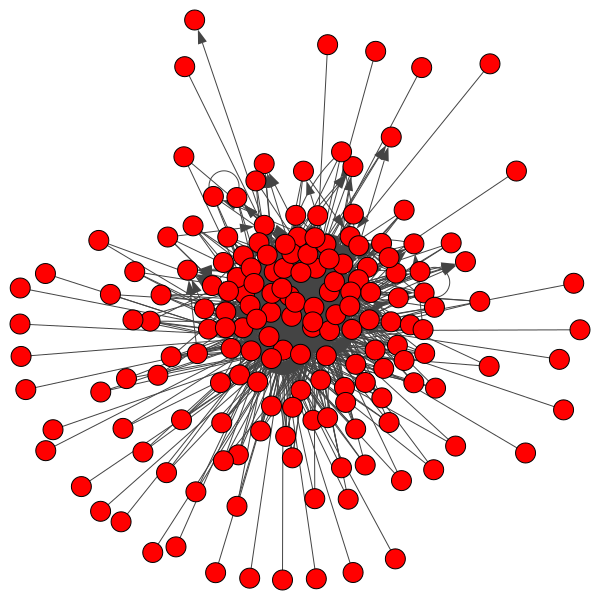

In [117]:
ig.plot(g_j)

In [118]:
g_j.diameter()

5

In [119]:
print( "Clustering Coefficient: ", g_j.transitivity_undirected())

Clustering Coefficient:  0.24672505151604357


In [120]:
np.mean(g_j.degree())

13.988505747126437

In [121]:
np.mean(g_j.strength(weights = 'weight'))

4978.367816091954

In [122]:
df_strength = pd.DataFrame({'name': list(g_j.vs['name']), 'weighted_degree':g_j.strength(weights = 'weight') } )
df_strength = df_strength.sort_values('weighted_degree', ascending = False).reset_index(drop = True)
df_strength

,name,weighted_degree
0,British Virgin Islands,232540.0
1,Panama,104014.0
2,Hong Kong,78946.0
3,Switzerland,76304.0
4,Bahamas,40402.0
...,...,...
169,Malawi,2.0
170,Nauru,2.0
171,Sudan,2.0
172,Saint Martin (French part),2.0


## Community Detection

### Label Propogation Community Detection

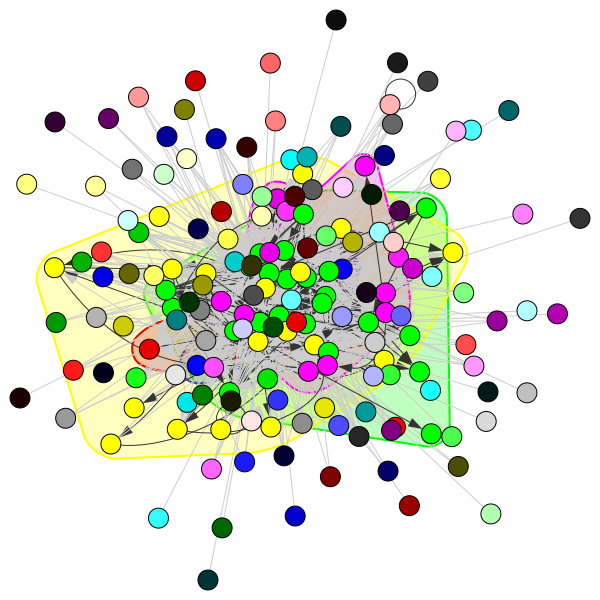

In [123]:
comm_lp_j= g_j.community_label_propagation(weights = 'weight')

ig.plot(comm_lp_j, mark_groups = True, layout="drl")

In [124]:
modularity = g_j.modularity(comm_lp_j, weights='weight')
print(modularity)

0.01501586664571409


In [125]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_lp_j))
print('average degree: ', get_avg_degree(comm_lp_j))
print('transitivity: ', get_transitivity(comm_lp_j))
print('diameter: ', get_diameter(comm_lp_j))

average weighted degree:  [0.0, 19787.652173913044, 30.0, 436.2352941176471, 166.85714285714286, 0.0, 0.0, 18.0, 0.0, 0.0, 0.0, 230.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 16.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 15.130434782608695, 1.0, 5.176470588235294, 4.571428571428571, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

### Leading Eigenvector Community Detection

/Users/susankoruthu/opt/anaconda3/lib/python3.8/site-packages/igraph/__init__.py:1281: RuntimeWarning: This method was developed for undirected graphs at src/community/leading_eigenvector.c:530
  membership, _, q = GraphBase.community_leading_eigenvector(


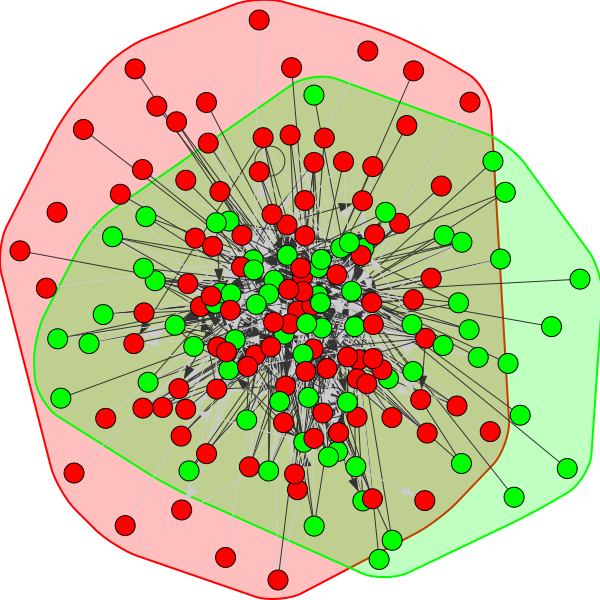

In [126]:
comm_leading_eigenvector_j= g_j.community_leading_eigenvector(weights = 'weight')

ig.plot(comm_leading_eigenvector_j, mark_groups = True, layout="drl")

In [127]:
modularity = g_j.modularity(comm_leading_eigenvector_j, weights='weight')
print(modularity)

0.13928311330179288


In [128]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_leading_eigenvector_j))
print('average degree: ', get_avg_degree(comm_leading_eigenvector_j))
print('transitivity: ', get_transitivity(comm_leading_eigenvector_j))
print('diameter: ', get_diameter(comm_leading_eigenvector_j))

average weighted degree:  [1792.4313725490197, 5410.888888888889]
average degree:  [5.2745098039215685, 9.61111111111111]
transitivity:  [0.1493288590604027, 0.33534222987516143]
diameter:  [3, 4]


In [129]:
df_leading_eigenvector_j= pd.DataFrame({'name': list(g_j.vs['name']), 'community':comm_leading_eigenvector_j.membership } )
df_leading_eigenvector_j

,name,community
0,Albania,0
1,Bahamas,0
2,Andorra,0
3,British Virgin Islands,1
4,Cayman Islands,1
...,...,...
169,Venezuela,0
170,Vietnam,1
171,Yemen,0
172,Zambia,1


In [130]:
df_leading_eigenvector_j.describe()

,community
count,174.000000
mean,0.413793
std,0.493934
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


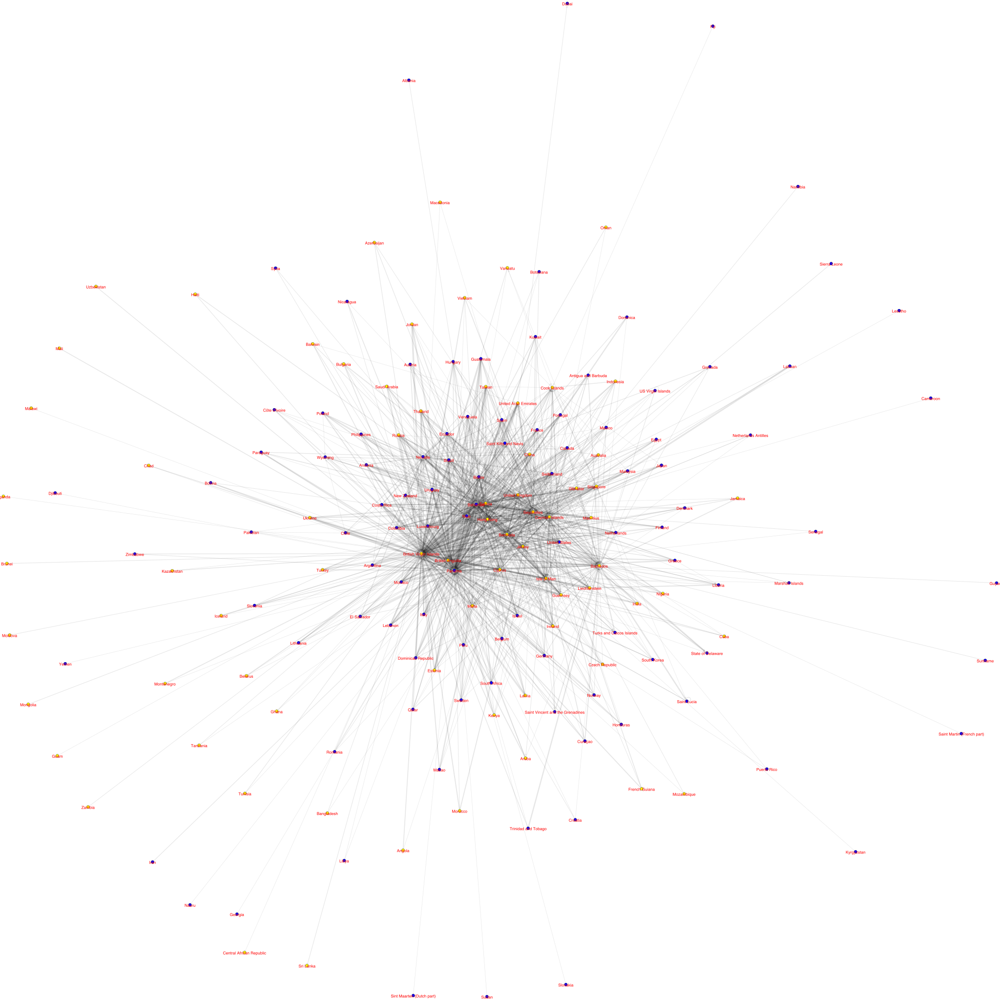

In [131]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_leading_eigenvector_j.membership)):
    vertex_colors.append(colors[comm_leading_eigenvector_j.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_j.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_j.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_j,'directed_all_jur_images/communities_leading_eigenvector.png', vertex_label = g_j.vs['name'] , **visual_style)

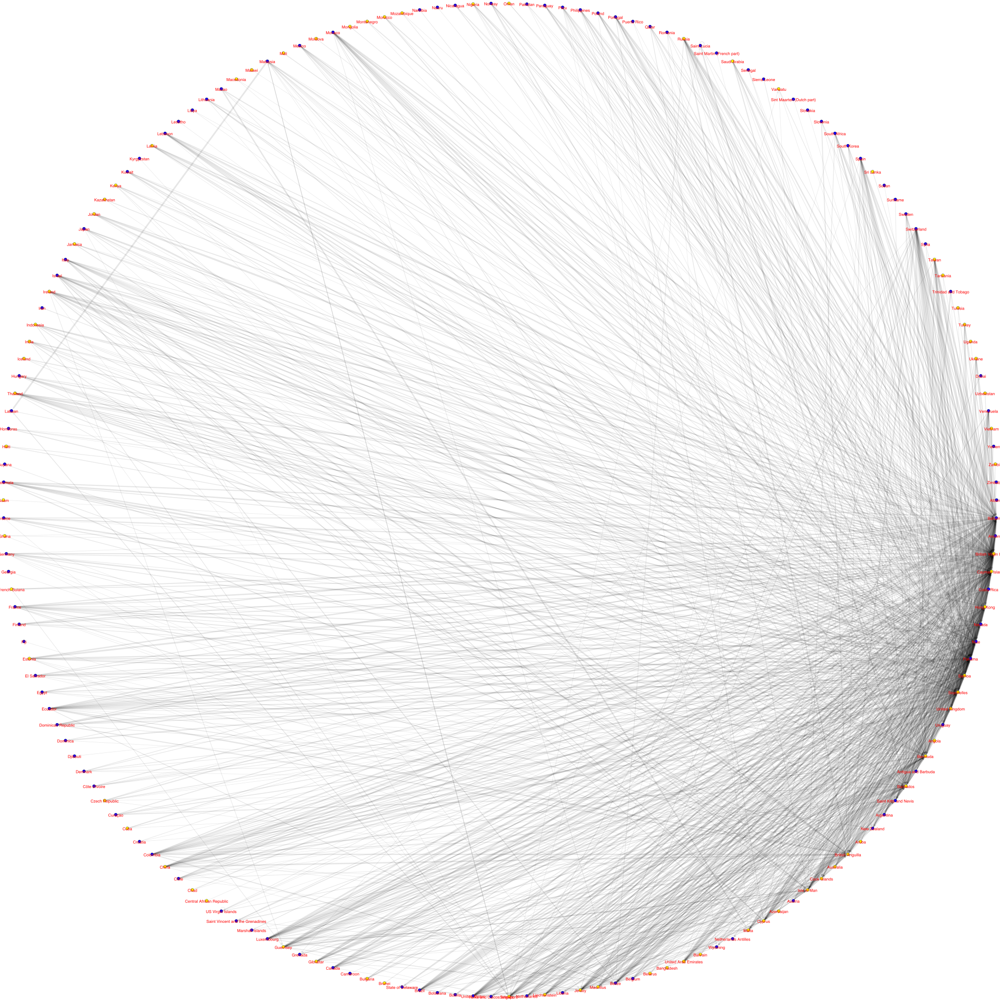

In [132]:
# Set the layout
my_layout = g_j.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_j,'directed_all_jur_images/leading_vector_circular.png', vertex_label = g_j.vs['name'] , **visual_style)

In [133]:
for i in range(len(comm_leading_eigenvector_j.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_leading_eigenvector_j.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_leading_eigenvector_j.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_leading_eigenvector_j.subgraphs()[i],'directed_all_jur_images/leading_eigenvector_subgraph' + str(i) + '.png' ,vertex_label = comm_leading_eigenvector_j.subgraphs()[i].vs['name'],**visual_style  )
    

### Spinglass Community Detection

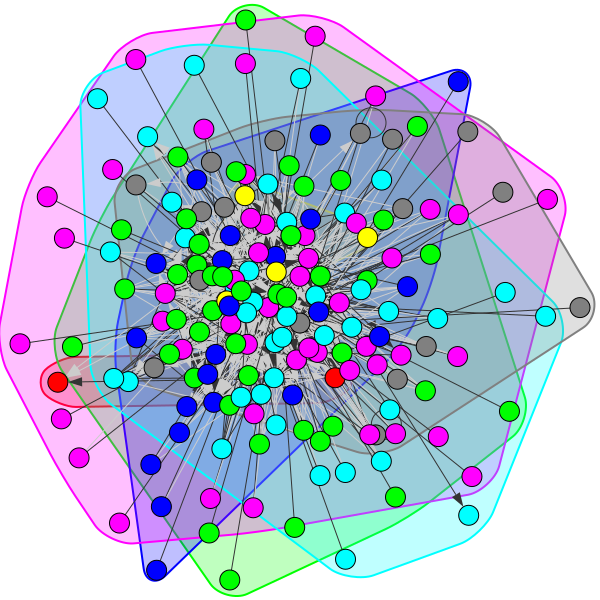

In [134]:
comm_spinglass_j = g_j.community_spinglass(weights = 'weight')

ig.plot(comm_spinglass_j, mark_groups = True, layout="drl")

In [135]:
modularity = g_j.modularity(comm_spinglass_j, weights='weight')
print(modularity)

0.10744485464817165


In [136]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_spinglass_j))
print('average degree: ', get_avg_degree(comm_spinglass_j))
print('transitivity: ', get_transitivity(comm_spinglass_j))
print('diameter: ', get_diameter(comm_spinglass_j))

average weighted degree:  [844.0, 1390.046511627907, 617.4545454545455, 125.0, 5249.106382978724, 1593.5384615384614, 109.41176470588235]
average degree:  [1.0, 2.558139534883721, 2.6363636363636362, 1.5, 4.25531914893617, 5.384615384615385, 2.1176470588235294]
transitivity:  [nan, 0.036223929747530186, 0.11764705882352941, 0.0, 0.19569743233865372, 0.3058933582787652, 0.0]
diameter:  [1, 2, 3, 2, 6, 4, 1]


In [137]:
df_spinglass_j = pd.DataFrame({'name': list(g_j.vs['name']), 'community':comm_spinglass_j.membership } )
df_spinglass_j

,name,community
0,Albania,2
1,Bahamas,2
2,Andorra,1
3,British Virgin Islands,4
4,Cayman Islands,5
...,...,...
169,Venezuela,1
170,Vietnam,5
171,Yemen,1
172,Zambia,4


In [138]:
df_spinglass_j.describe()

,community
count,174.000000
mean,3.356322
std,1.776383
min,0.000000
25%,1.000000
50%,4.000000
75%,5.000000
max,6.000000


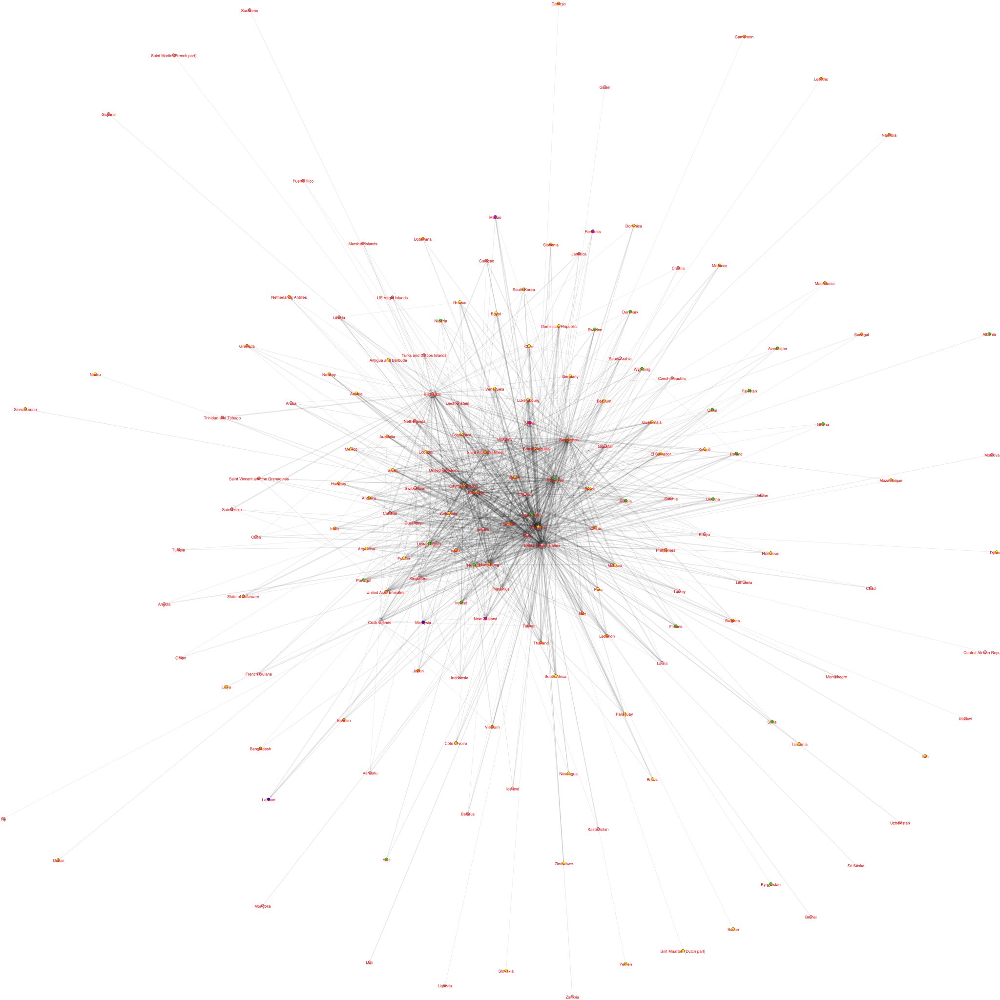

In [139]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_spinglass_j.membership)):
    vertex_colors.append(colors[comm_spinglass_j.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_j.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_j.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_j,'directed_all_jur_images/communities_spinglass.png', vertex_label = g_j.vs['name'] , **visual_style)

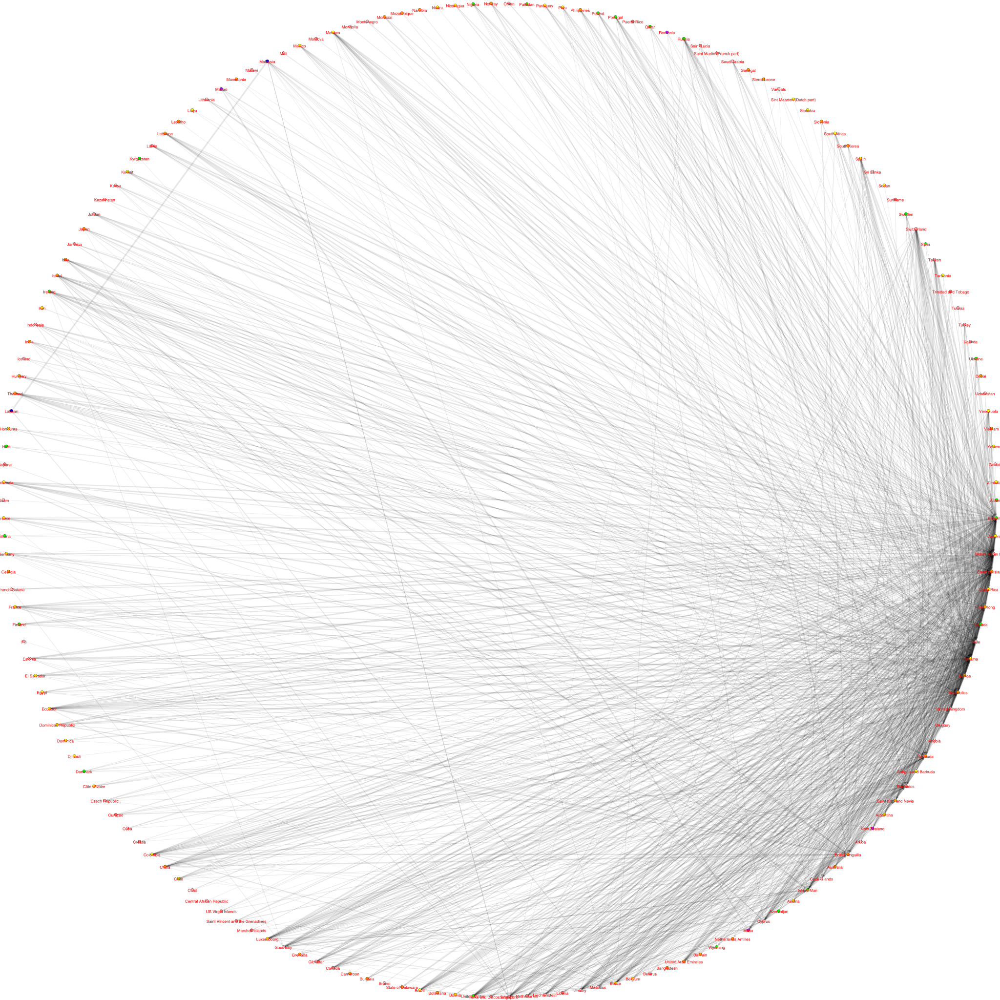

In [140]:
# Set the layout
my_layout = g_j.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_j,'directed_all_jur_images/spinglass_circular.png', vertex_label = g_j.vs['name'] , **visual_style)

In [141]:
for i in range(len(comm_spinglass_j.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_spinglass_j.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_spinglass_j.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_spinglass_j.subgraphs()[i],'directed_all_jur_images/spinglass_subgraph' + str(i) + '.png' ,vertex_label = comm_spinglass_j.subgraphs()[i].vs['name'],**visual_style  )
    

### Walktrap Community Detection

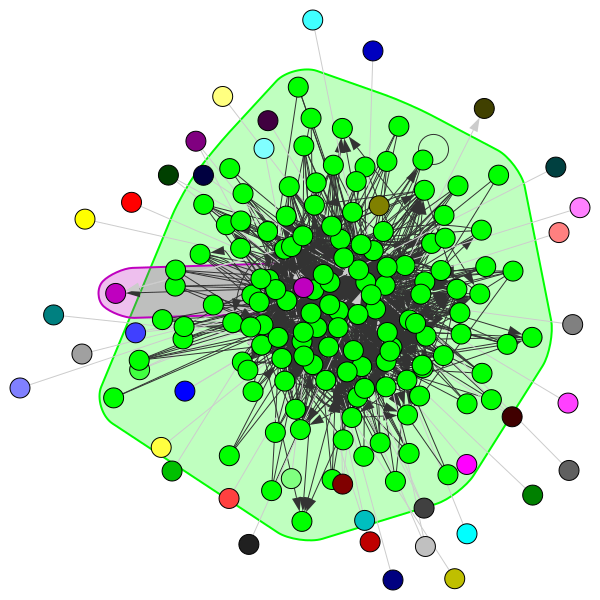

In [142]:
walktrap_j = g_j.community_walktrap(weights = 'weight', steps = 2)

comm_walktrap_j = walktrap_j.as_clustering()

ig.plot(comm_walktrap_j, mark_groups = True, layout="drl")

In [143]:
modularity = g_j.modularity(comm_walktrap_j, weights='weight')
print(modularity)

0.003887288169812182


In [144]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_walktrap_j))
print('average degree: ', get_avg_degree(comm_walktrap_j))
print('transitivity: ', get_transitivity(comm_walktrap_j))
print('diameter: ', get_diameter(comm_walktrap_j))

average weighted degree:  [0.0, 6544.272727272727, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 844.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 17.439393939393938, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
transitivity:  [nan, 0.27605592593366635, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]
diameter:  [0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [145]:
df_walktrap_j = pd.DataFrame({'name': list(g_j.vs['name']), 'community':comm_walktrap_j.membership } )
df_walktrap_j

,name,community
0,Albania,0
1,Bahamas,1
2,Andorra,1
3,British Virgin Islands,1
4,Cayman Islands,1
...,...,...
169,Venezuela,1
170,Vietnam,1
171,Yemen,40
172,Zambia,41


In [146]:
df_walktrap_j.describe()

,community
count,174.000000
mean,5.764368
std,10.282523
min,0.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,41.000000


In [147]:
# ##plot community
# visual_style = {}

# vertex_colors = []

# for i in range(len(comm_walktrap_j.membership)):
#     vertex_colors.append(colors[comm_walktrap_j.membership[i]])
    
# # Set bbox and margin
# visual_style["bbox"] = (5000,5000)
# visual_style["margin"] = 17

# # Set vertex colours
# visual_style["vertex_color"] = vertex_colors

# # Set edge width
# visual_style["edge_width"] = np.log(g_j.es['weight']) + 1

# # Set edge color
# visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# # Set vertex size
# visual_style["vertex_size"] = 15

# # Set vertex label size
# visual_style["vertex_label_size"] = 20

# # Set vertex label color
# visual_style["vertex_label_color"] = 'red'

# # Don't curve the edges
# visual_style["edge_curved"] = False

# # Set the layout
# my_layout = g_j.layout_fruchterman_reingold()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_j,'directed_all_jur_images/communities_walktrap.png', vertex_label = g_j.vs['name'] , **visual_style)

In [148]:
# # Set the layout
# my_layout = g_j.layout_circle()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_j,'directed_all_jur_images/walktrap_circular.png', vertex_label = g_j.vs['name'] , **visual_style)

In [149]:
# for i in range(len(comm_walktrap_j.subgraphs())):
    
#     visual_style["bbox"] = (2000,2000)
#     visual_style["margin"] = 17
    
#     # Set vertex colours
#     visual_style["vertex_color"] = 'green'

#     # Set edge width
#     visual_style["edge_width"] = np.log(comm_walktrap_j.subgraphs()[i].es['weight']) + 1
#     # Set the layout
#     my_layout = comm_walktrap_j.subgraphs()[i].layout_fruchterman_reingold()
#     visual_style["layout"] = my_layout

#     ig.plot(comm_walktrap_j.subgraphs()[i],'directed_all_jur_images/walktrap_subgraph' + str(i) + '.png' ,vertex_label = comm_walktrap_j.subgraphs()[i].vs['name'],**visual_style  )
    

### Infomap Community Detection

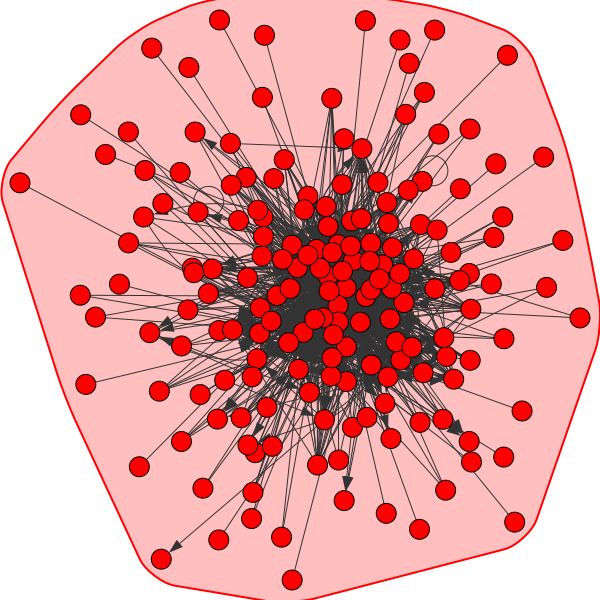

In [150]:
comm_infomap_j = g_j.community_infomap(edge_weights = 'weight')

ig.plot(comm_infomap_j, mark_groups = True, layout="drl")

In [151]:
modularity = g_j.modularity(comm_infomap_j, weights='weight')
print(modularity)

0.0


In [152]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_infomap_j))
print('average degree: ', get_avg_degree(comm_infomap_j))
print('transitivity: ', get_transitivity(comm_infomap_j))
print('diameter: ', get_diameter(comm_infomap_j))

average weighted degree:  [4978.367816091954]
average degree:  [13.988505747126437]
transitivity:  [0.24672505151604357]
diameter:  [5]


In [153]:
df_infomap_j = pd.DataFrame({'name': list(g_j.vs['name']), 'community':comm_infomap_j.membership } )
df_infomap_j

,name,community
0,Albania,0
1,Bahamas,0
2,Andorra,0
3,British Virgin Islands,0
4,Cayman Islands,0
...,...,...
169,Venezuela,0
170,Vietnam,0
171,Yemen,0
172,Zambia,0


# Officer Jurisdiction

In [154]:
df_weighted['status'].unique()

array(['jurisdiction', 'intermediary_base', 'intermediary_jurisdiction',
       'officer_base', 'officer_jurisdiction'], dtype=object)

In [155]:
jurisdiction_list = ['officer_jurisdiction']

In [156]:
df_weighted_jur = df_weighted[df_weighted['status'].isin(jurisdiction_list)]
df_jur = df_weighted_jur.drop(['status'], axis = 1)
df_jur

,node_start,node_end,weight
221026,Jersey,British Virgin Islands,0.5
221027,China,British Virgin Islands,0.5
221028,China,British Virgin Islands,0.5
221029,United States,British Virgin Islands,0.5
221030,Indonesia,British Virgin Islands,0.5
...,...,...,...
221136,Indonesia,Samoa,0.5
221137,Cayman Islands,Samoa,0.5
221138,British Virgin Islands,Samoa,0.5
221139,China,Samoa,0.5


In [157]:
df_jur_grouped = df_jur.groupby(['node_start','node_end'], as_index = False).sum()
df_jur_grouped

,node_start,node_end,weight
0,British Virgin Islands,Cook Islands,0.5
1,British Virgin Islands,Samoa,0.5
2,British Virgin Islands,Seychelles,0.5
3,Canada,British Virgin Islands,0.5
4,Cayman Islands,British Virgin Islands,0.5
5,Cayman Islands,Samoa,0.5
6,China,British Virgin Islands,7.5
7,China,Labuan,0.5
8,China,Samoa,1.0
9,China,Singapore,0.5


### Convert Data to an Undirected Edge List

In [158]:
# df_jur_grouped_list = df_jur_grouped.values.tolist()
# df_jur_grouped_list

In [159]:
# d = collections.defaultdict(int)
# for n1, n2, v in df_jur_grouped_list:
#     d[min(n1, n2), max(n1, n2)] += v
# result = [[k[0], k[1], v] for k, v in d.items()]

In [160]:
# df_net = pd.DataFrame(result)
# df_net

In [161]:
# df_net = df_net.rename(columns = {0:'node_1', 1:'node_2', 2: 'weight'})
# df_net

In [162]:
#df_net.to_csv('undirected_weighted_grouped.csv', index = False)

In [163]:
# df_net.describe()

## Create Graph

In [164]:
g_oj = ig.Graph.TupleList(df_jur_grouped.itertuples(index=False), directed=True, edge_attrs={'weight': "weight"})


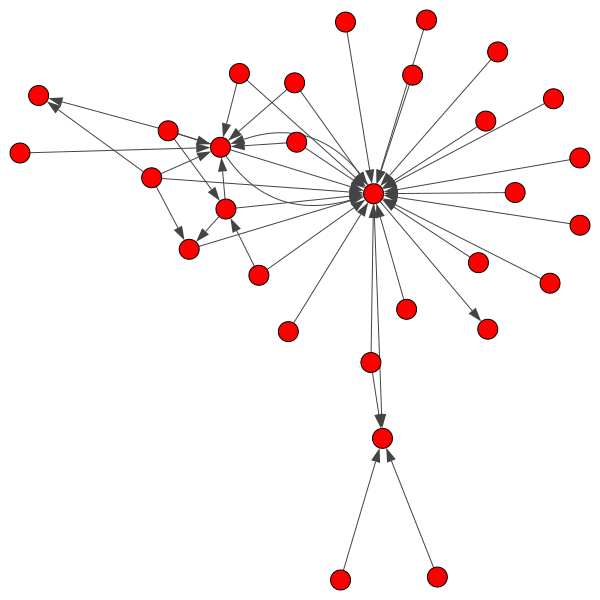

In [165]:
ig.plot(g_oj)

In [166]:
g_oj.diameter()

3

In [167]:
print( "Clustering Coefficient: ", g_oj.transitivity_undirected())

Clustering Coefficient:  0.09863013698630137


In [168]:
np.mean(g_oj.degree())

2.8

In [169]:
np.mean(g_oj.strength(weights = 'weight'))

3.8333333333333335

In [170]:
df_strength = pd.DataFrame({'name': list(g_oj.vs['name']), 'weighted_degree':g_oj.strength(weights = 'weight') } )
df_strength = df_strength.sort_values('weighted_degree', ascending = False).reset_index(drop = True)
df_strength

,name,weighted_degree
0,British Virgin Islands,48.5
1,Taiwan,12.5
2,China,9.5
3,Hong Kong,7.0
4,Samoa,5.0
5,Indonesia,5.0
6,United States,4.5
7,Singapore,3.5
8,Cook Islands,2.5
9,India,2.5


## Community Detection

### Label Propogation Community Detection

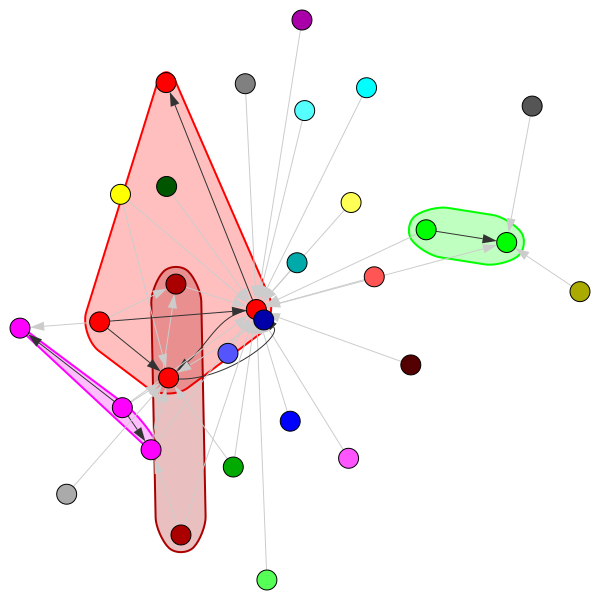

In [171]:
comm_lp_oj= g_oj.community_label_propagation(weights = 'weight')

ig.plot(comm_lp_oj, mark_groups = True, layout="drl")

In [172]:
modularity = g_oj.modularity(comm_lp_oj, weights='weight')
print(modularity)

0.020037807183364852


In [173]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_lp_oj))
print('average degree: ', get_avg_degree(comm_lp_oj))
print('transitivity: ', get_transitivity(comm_lp_oj))
print('diameter: ', get_diameter(comm_lp_oj))

average weighted degree:  [6.5, 1.0, 0.0, 0.0, 0.6666666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [2.5, 1.0, 0.0, 0.0, 1.3333333333333333, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
transitivity:  [0.6, nan, nan, nan, 0.0, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]
diameter:  [2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


### Leading Eigenvector Community Detection

/Users/susankoruthu/opt/anaconda3/lib/python3.8/site-packages/igraph/__init__.py:1281: RuntimeWarning: This method was developed for undirected graphs at src/community/leading_eigenvector.c:530
  membership, _, q = GraphBase.community_leading_eigenvector(


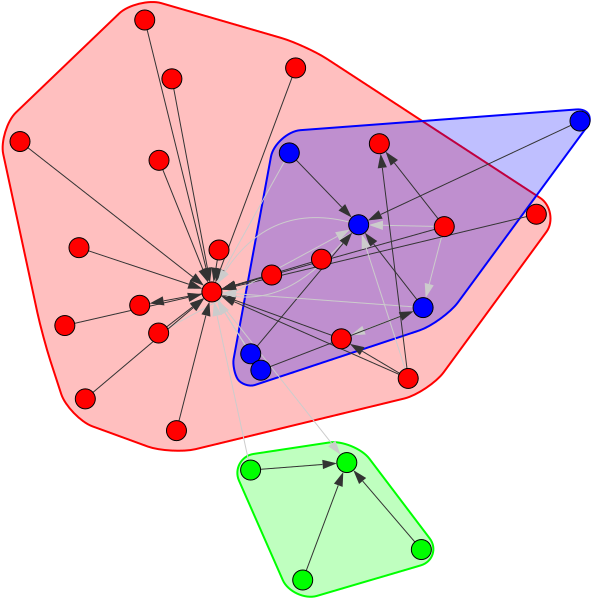

In [174]:
comm_leading_eigenvector_oj= g_oj.community_leading_eigenvector(weights = 'weight')

ig.plot(comm_leading_eigenvector_oj, mark_groups = True, layout="drl")

In [175]:
modularity = g_oj.modularity(comm_leading_eigenvector_oj, weights='weight')
print(modularity)

0.10638941398865785


In [176]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_leading_eigenvector_oj))
print('average degree: ', get_avg_degree(comm_leading_eigenvector_oj))
print('transitivity: ', get_transitivity(comm_leading_eigenvector_oj))
print('diameter: ', get_diameter(comm_leading_eigenvector_oj))

average weighted degree:  [4.05, 1.0, 0.8333333333333334]
average degree:  [2.1, 1.5, 1.6666666666666667]
transitivity:  [0.018867924528301886, 0.0, 0.0]
diameter:  [2, 1, 2]


In [177]:
df_leading_eigenvector_oj= pd.DataFrame({'name': list(g_oj.vs['name']), 'community':comm_leading_eigenvector_oj.membership } )
df_leading_eigenvector_oj

,name,community
0,British Virgin Islands,0
1,Cook Islands,1
2,Samoa,2
3,Seychelles,0
4,Canada,0
5,Cayman Islands,2
6,China,0
7,Labuan,0
8,Singapore,2
9,Czech Republic,0


In [178]:
df_leading_eigenvector_oj.describe()

,community
count,30.000000
mean,0.533333
std,0.819307
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,2.000000


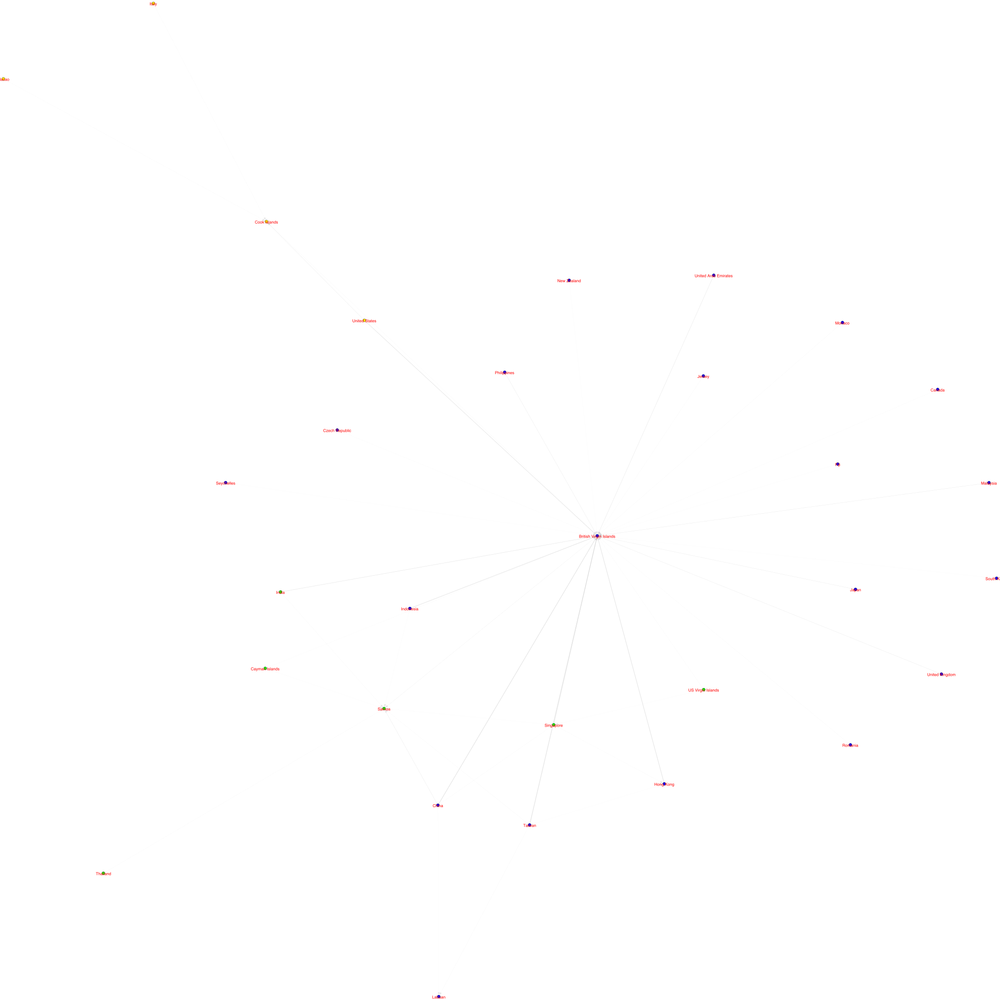

In [179]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_leading_eigenvector_oj.membership)):
    vertex_colors.append(colors[comm_leading_eigenvector_oj.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_oj.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_oj.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_oj,'directed_all_jur_images/communities_leading_eigenvector.png', vertex_label = g_oj.vs['name'] , **visual_style)

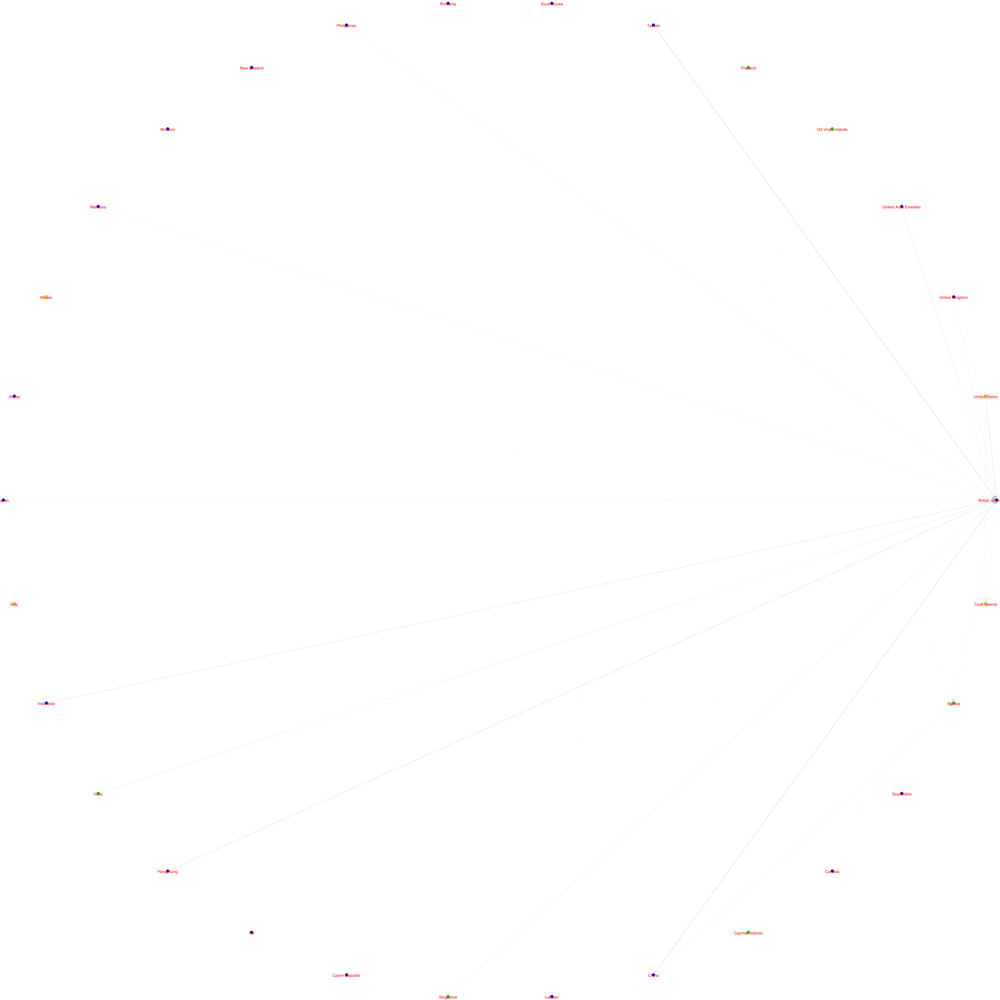

In [180]:
# Set the layout
my_layout = g_oj.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_oj,'directed_all_jur_images/leading_vector_circular.png', vertex_label = g_oj.vs['name'] , **visual_style)

In [181]:
for i in range(len(comm_leading_eigenvector_oj.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_leading_eigenvector_oj.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_leading_eigenvector_oj.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_leading_eigenvector_oj.subgraphs()[i],'directed_all_jur_images/leading_eigenvector_subgraph' + str(i) + '.png' ,vertex_label = comm_leading_eigenvector_oj.subgraphs()[i].vs['name'],**visual_style  )
    

### Spinglass Community Detection

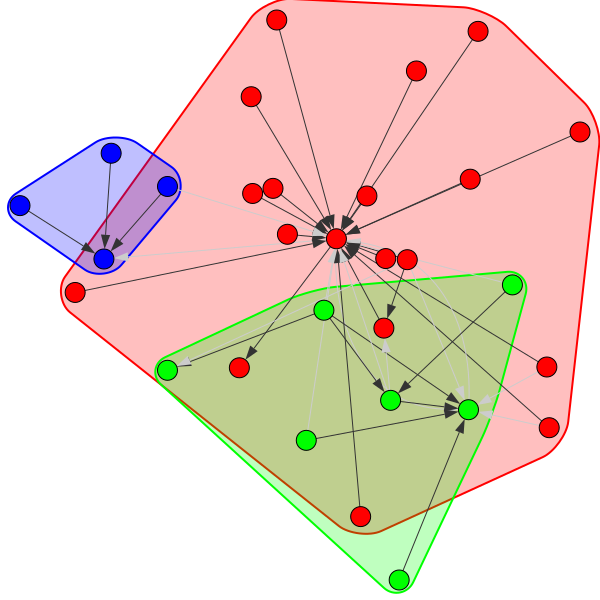

In [182]:
comm_spinglass_oj = g_oj.community_spinglass(weights = 'weight')

ig.plot(comm_spinglass_oj, mark_groups = True, layout="drl")

In [183]:
modularity = g_oj.modularity(comm_spinglass_oj, weights='weight')
print(modularity)

0.11924385633270315


In [184]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_spinglass_oj))
print('average degree: ', get_avg_degree(comm_spinglass_oj))
print('transitivity: ', get_transitivity(comm_spinglass_oj))
print('diameter: ', get_diameter(comm_spinglass_oj))

average weighted degree:  [3.5789473684210527, 1.1428571428571428, 1.0]
average degree:  [2.0, 2.0, 1.5]
transitivity:  [0.01935483870967742, 0.25, 0.0]
diameter:  [2, 2, 1]


In [185]:
df_spinglass_oj = pd.DataFrame({'name': list(g_oj.vs['name']), 'community':comm_spinglass_oj.membership } )
df_spinglass_oj

,name,community
0,British Virgin Islands,0
1,Cook Islands,2
2,Samoa,1
3,Seychelles,0
4,Canada,0
5,Cayman Islands,1
6,China,1
7,Labuan,1
8,Singapore,1
9,Czech Republic,0


In [186]:
df_spinglass_oj.describe()

,community
count,30.000000
mean,0.500000
std,0.731083
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,2.000000


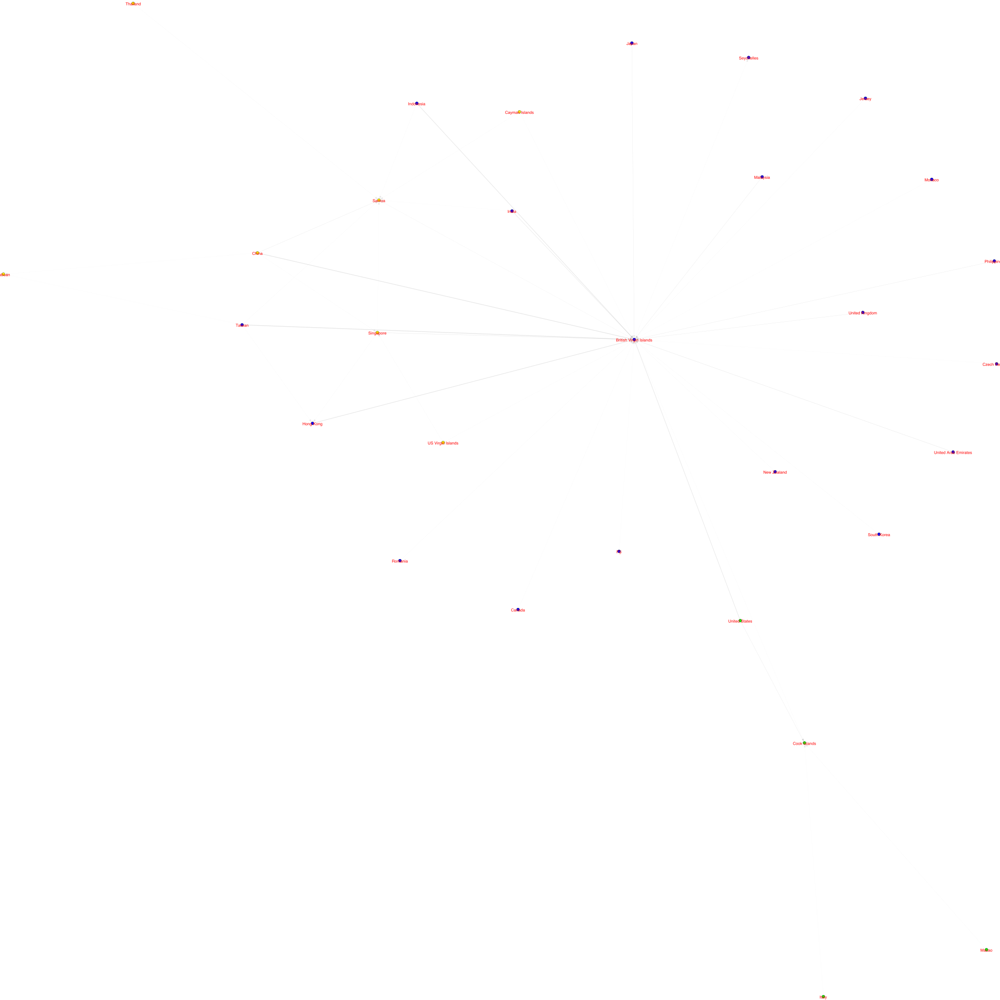

In [187]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_spinglass_oj.membership)):
    vertex_colors.append(colors[comm_spinglass_oj.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_oj.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_oj.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_oj,'directed_all_jur_images/communities_spinglass.png', vertex_label = g_oj.vs['name'] , **visual_style)

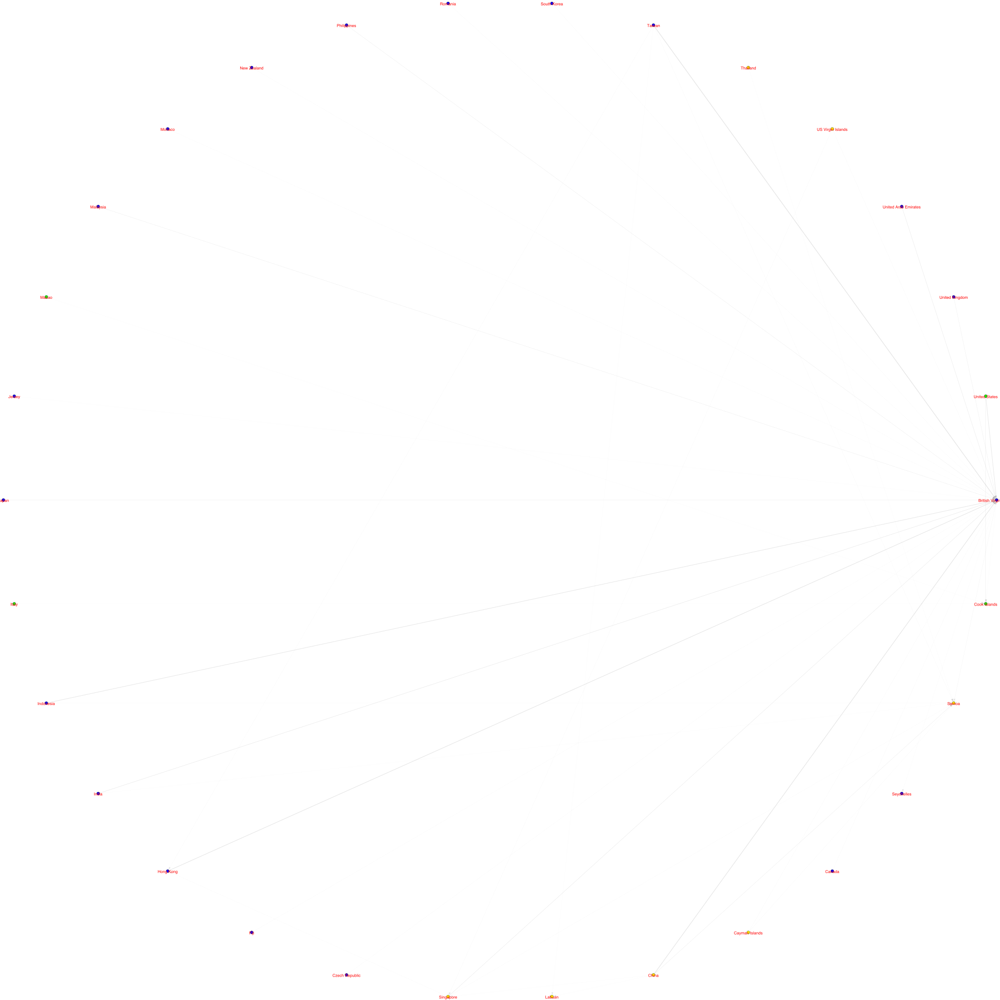

In [188]:
# Set the layout
my_layout = g_oj.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_oj,'directed_all_jur_images/spinglass_circular.png', vertex_label = g_oj.vs['name'] , **visual_style)

In [189]:
for i in range(len(comm_spinglass_oj.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_spinglass_oj.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_spinglass_oj.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_spinglass_oj.subgraphs()[i],'directed_all_jur_images/spinglass_subgraph' + str(i) + '.png' ,vertex_label = comm_spinglass_oj.subgraphs()[i].vs['name'],**visual_style  )
    

### Walktrap Community Detection

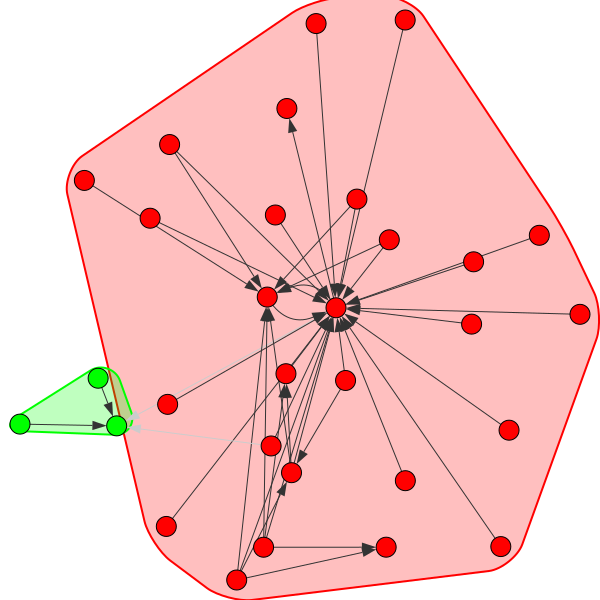

In [190]:
walktrap_oj = g_oj.community_walktrap(weights = 'weight', steps = 2)

comm_walktrap_oj = walktrap_oj.as_clustering()

ig.plot(comm_walktrap_oj, mark_groups = True, layout="drl")

In [191]:
modularity = g_oj.modularity(comm_walktrap_oj, weights='weight')
print(modularity)

0.03327032136105858


In [192]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_walktrap_oj))
print('average degree: ', get_avg_degree(comm_walktrap_oj))
print('transitivity: ', get_transitivity(comm_walktrap_oj))
print('diameter: ', get_diameter(comm_walktrap_oj))

average weighted degree:  [4.074074074074074, 0.6666666666666666]
average degree:  [2.814814814814815, 1.3333333333333333]
transitivity:  [0.09880239520958084, 0.0]
diameter:  [3, 1]


In [193]:
df_walktrap_oj = pd.DataFrame({'name': list(g_oj.vs['name']), 'community':comm_walktrap_oj.membership } )
df_walktrap_oj

,name,community
0,British Virgin Islands,0
1,Cook Islands,1
2,Samoa,0
3,Seychelles,0
4,Canada,0
5,Cayman Islands,0
6,China,0
7,Labuan,0
8,Singapore,0
9,Czech Republic,0


In [194]:
df_walktrap_oj.describe()

,community
count,30.000000
mean,0.100000
std,0.305129
min,0.000000
25%,0.000000
50%,0.000000
75%,0.000000
max,1.000000


In [195]:
# ##plot community
# visual_style = {}

# vertex_colors = []

# for i in range(len(comm_walktrap_oj.membership)):
#     vertex_colors.append(colors[comm_walktrap_oj.membership[i]])
    
# # Set bbox and margin
# visual_style["bbox"] = (5000,5000)
# visual_style["margin"] = 17

# # Set vertex colours
# visual_style["vertex_color"] = vertex_colors

# # Set edge width
# visual_style["edge_width"] = np.log(g_oj.es['weight']) + 1

# # Set edge color
# visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# # Set vertex size
# visual_style["vertex_size"] = 15

# # Set vertex label size
# visual_style["vertex_label_size"] = 20

# # Set vertex label color
# visual_style["vertex_label_color"] = 'red'

# # Don't curve the edges
# visual_style["edge_curved"] = False

# # Set the layout
# my_layout = g_oj.layout_fruchterman_reingold()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_oj,'directed_all_jur_images/communities_walktrap.png', vertex_label = g_oj.vs['name'] , **visual_style)

In [196]:
# # Set the layout
# my_layout = g_oj.layout_circle()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_oj,'directed_all_jur_images/walktrap_circular.png', vertex_label = g_oj.vs['name'] , **visual_style)

In [197]:
# for i in range(len(comm_walktrap_oj.subgraphs())):
    
#     visual_style["bbox"] = (2000,2000)
#     visual_style["margin"] = 17
    
#     # Set vertex colours
#     visual_style["vertex_color"] = 'green'

#     # Set edge width
#     visual_style["edge_width"] = np.log(comm_walktrap_oj.subgraphs()[i].es['weight']) + 1
#     # Set the layout
#     my_layout = comm_walktrap_oj.subgraphs()[i].layout_fruchterman_reingold()
#     visual_style["layout"] = my_layout

#     ig.plot(comm_walktrap_oj.subgraphs()[i],'directed_all_jur_images/walktrap_subgraph' + str(i) + '.png' ,vertex_label = comm_walktrap_oj.subgraphs()[i].vs['name'],**visual_style  )
    

### Infomap Community Detection

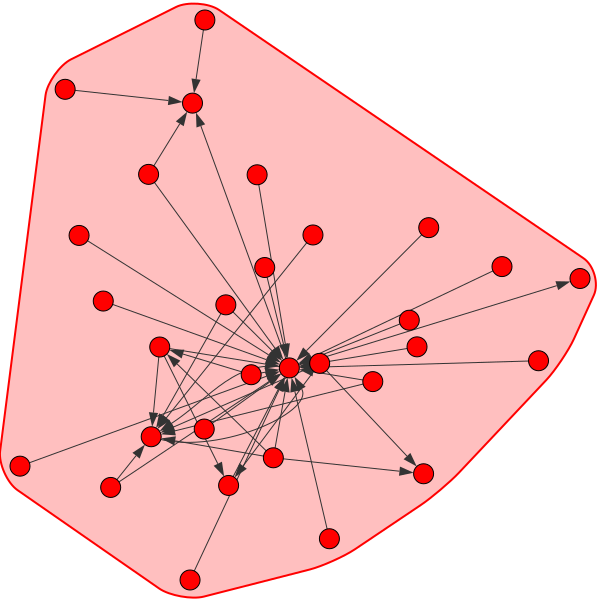

In [198]:
comm_infomap_oj = g_oj.community_infomap(edge_weights = 'weight')

ig.plot(comm_infomap_oj, mark_groups = True, layout="drl")

In [199]:
modularity = g_oj.modularity(comm_infomap_oj, weights='weight')
print(modularity)

0.0


In [200]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_infomap_oj))
print('average degree: ', get_avg_degree(comm_infomap_oj))
print('transitivity: ', get_transitivity(comm_infomap_oj))
print('diameter: ', get_diameter(comm_infomap_oj))

average weighted degree:  [3.8333333333333335]
average degree:  [2.8]
transitivity:  [0.09863013698630137]
diameter:  [3]


In [201]:
df_infomap_oj = pd.DataFrame({'name': list(g_oj.vs['name']), 'community':comm_infomap_oj.membership } )
df_infomap_oj

,name,community
0,British Virgin Islands,0
1,Cook Islands,0
2,Samoa,0
3,Seychelles,0
4,Canada,0
5,Cayman Islands,0
6,China,0
7,Labuan,0
8,Singapore,0
9,Czech Republic,0


# No Intermediary

In [202]:
df_weighted['status'].unique()

array(['jurisdiction', 'intermediary_base', 'intermediary_jurisdiction',
       'officer_base', 'officer_jurisdiction'], dtype=object)

In [203]:
jurisdiction_list = ['officer_jurisdiction', 'jurisdiction', 'officer_base']

In [204]:
df_weighted_jur = df_weighted[df_weighted['status'].isin(jurisdiction_list)]
df_jur = df_weighted_jur.drop(['status'], axis = 1)
df_jur

,node_start,node_end,weight
0,Hong Kong,Samoa,2.0
1,Hong Kong,Samoa,2.0
2,Hong Kong,Samoa,2.0
3,Hong Kong,Samoa,2.0
4,Hong Kong,Samoa,2.0
...,...,...,...
338119,Indonesia,British Virgin Islands,1.0
338120,Cook Islands,British Virgin Islands,1.0
338121,Hong Kong,British Virgin Islands,1.0
338122,Cook Islands,United Kingdom,1.0


In [205]:
df_jur_grouped = df_jur.groupby(['node_start','node_end'], as_index = False).sum()
df_jur_grouped

,node_start,node_end,weight
0,Albania,Bahamas,4.0
1,Algeria,British Virgin Islands,2.0
2,Algeria,United Kingdom,2.0
3,Algeria,United States,1.0
4,Andorra,Bahamas,52.0
...,...,...,...
2750,Zimbabwe,Hong Kong,3.0
2751,Zimbabwe,Jersey,1.0
2752,Zimbabwe,Panama,6.0
2753,Zimbabwe,Russia,2.0


### Convert Data to an Undirected Edge List

In [206]:
# df_jur_grouped_list = df_jur_grouped.values.tolist()
# df_jur_grouped_list

In [207]:
# d = collections.defaultdict(int)
# for n1, n2, v in df_jur_grouped_list:
#     d[min(n1, n2), max(n1, n2)] += v
# result = [[k[0], k[1], v] for k, v in d.items()]

In [208]:
# df_net = pd.DataFrame(result)
# df_net

In [209]:
# df_net = df_net.rename(columns = {0:'node_1', 1:'node_2', 2: 'weight'})
# df_net

In [210]:
#df_net.to_csv('undirected_weighted_grouped.csv', index = False)

In [211]:
# df_net.describe()

## Create Graph

In [212]:
g_ni = ig.Graph.TupleList(df_jur_grouped.itertuples(index=False), directed=True, edge_attrs={'weight': "weight"})


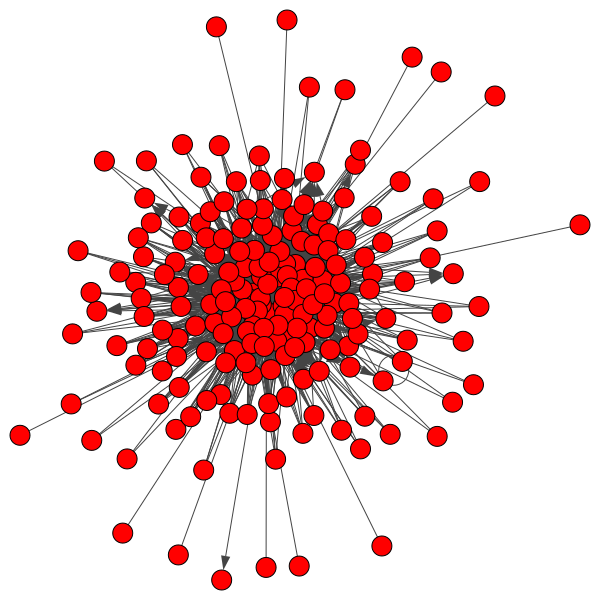

In [213]:
ig.plot(g_ni)

In [214]:
g_ni.diameter()

4

In [215]:
print( "Clustering Coefficient: ", g_ni.transitivity_undirected())

Clustering Coefficient:  0.3829243625911535


In [216]:
np.mean(g_ni.degree())

28.256410256410255

In [217]:
np.mean(g_ni.strength(weights = 'weight'))

5595.635897435897

In [218]:
df_strength = pd.DataFrame({'name': list(g_ni.vs['name']), 'weighted_degree':g_ni.strength(weights = 'weight') } )
df_strength = df_strength.sort_values('weighted_degree', ascending = False).reset_index(drop = True)
df_strength

,name,weighted_degree
0,British Virgin Islands,283283.5
1,Hong Kong,110569.0
2,Panama,109720.0
3,Switzerland,77116.0
4,Bahamas,40682.0
...,...,...
190,Guinea,2.0
191,Yemen,2.0
192,Sudan,2.0
193,Benin,1.0


## Community Detection

### Label Propogation Community Detection

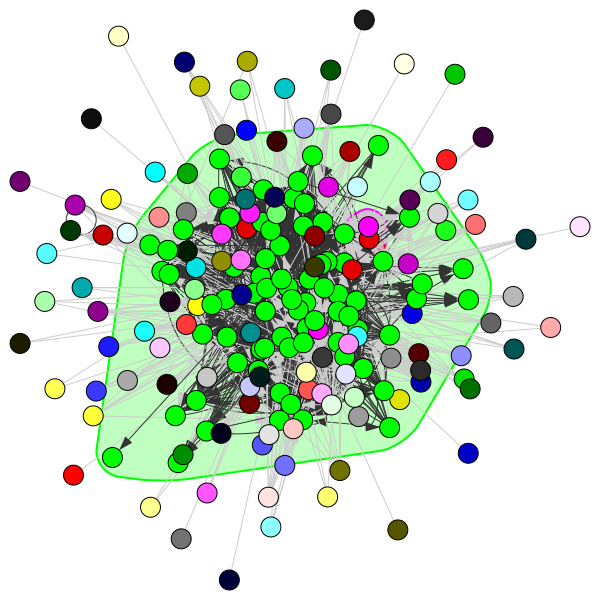

In [219]:
comm_lp_ni= g_ni.community_label_propagation(weights = 'weight')

ig.plot(comm_lp_ni, mark_groups = True, layout="drl")

In [220]:
modularity = g_ni.modularity(comm_lp_ni, weights='weight')
print(modularity)

0.001266623430772373


In [221]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_lp_ni))
print('average degree: ', get_avg_degree(comm_lp_ni))
print('transitivity: ', get_transitivity(comm_lp_ni))
print('diameter: ', get_diameter(comm_lp_ni))

average weighted degree:  [0.0, 13317.28, 0.0, 0.0, 84.0, 0.0, 0.0, 165.33333333333334, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 16.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 44.16, 0.0, 0.0, 1.0, 0.0, 0.0, 1.3333333333333333, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

### Leading Eigenvector Community Detection

/Users/susankoruthu/opt/anaconda3/lib/python3.8/site-packages/igraph/__init__.py:1281: RuntimeWarning: This method was developed for undirected graphs at src/community/leading_eigenvector.c:530
  membership, _, q = GraphBase.community_leading_eigenvector(


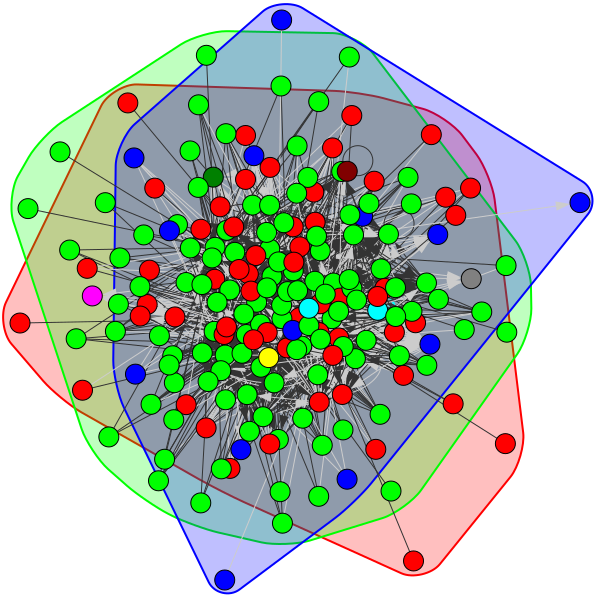

In [222]:
comm_leading_eigenvector_ni= g_ni.community_leading_eigenvector(weights = 'weight')

ig.plot(comm_leading_eigenvector_ni, mark_groups = True, layout="drl")

In [223]:
modularity = g_ni.modularity(comm_leading_eigenvector_ni, weights='weight')
print(modularity)

0.14956936235767823


In [224]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_leading_eigenvector_ni))
print('average degree: ', get_avg_degree(comm_leading_eigenvector_ni))
print('transitivity: ', get_transitivity(comm_leading_eigenvector_ni))
print('diameter: ', get_diameter(comm_leading_eigenvector_ni))

average weighted degree:  [3397.7586206896553, 4895.692307692308, 0.0, 0.0, 0.0, 1.0, 0.0, 16.0, 0.0]
average degree:  [8.206896551724139, 23.53846153846154, 0.0, 0.0, 0.0, 1.0, 0.0, 2.0, 0.0]
transitivity:  [0.27990271943400397, 0.44260359931244436, nan, nan, nan, nan, nan, nan, nan]
diameter:  [3, 3, 0, 0, 0, 1, 0, 0, 0]


In [225]:
df_leading_eigenvector_ni= pd.DataFrame({'name': list(g_ni.vs['name']), 'community':comm_leading_eigenvector_ni.membership } )
df_leading_eigenvector_ni

,name,community
0,Albania,0
1,Bahamas,0
2,Algeria,1
3,British Virgin Islands,1
4,United Kingdom,1
...,...,...
190,Venezuela,0
191,Vietnam,1
192,Yemen,0
193,Zambia,1


In [226]:
df_leading_eigenvector_ni.describe()

,community
count,195.000000
mean,0.928205
std,1.076925
min,0.000000
25%,0.000000
50%,1.000000
75%,1.000000
max,8.000000


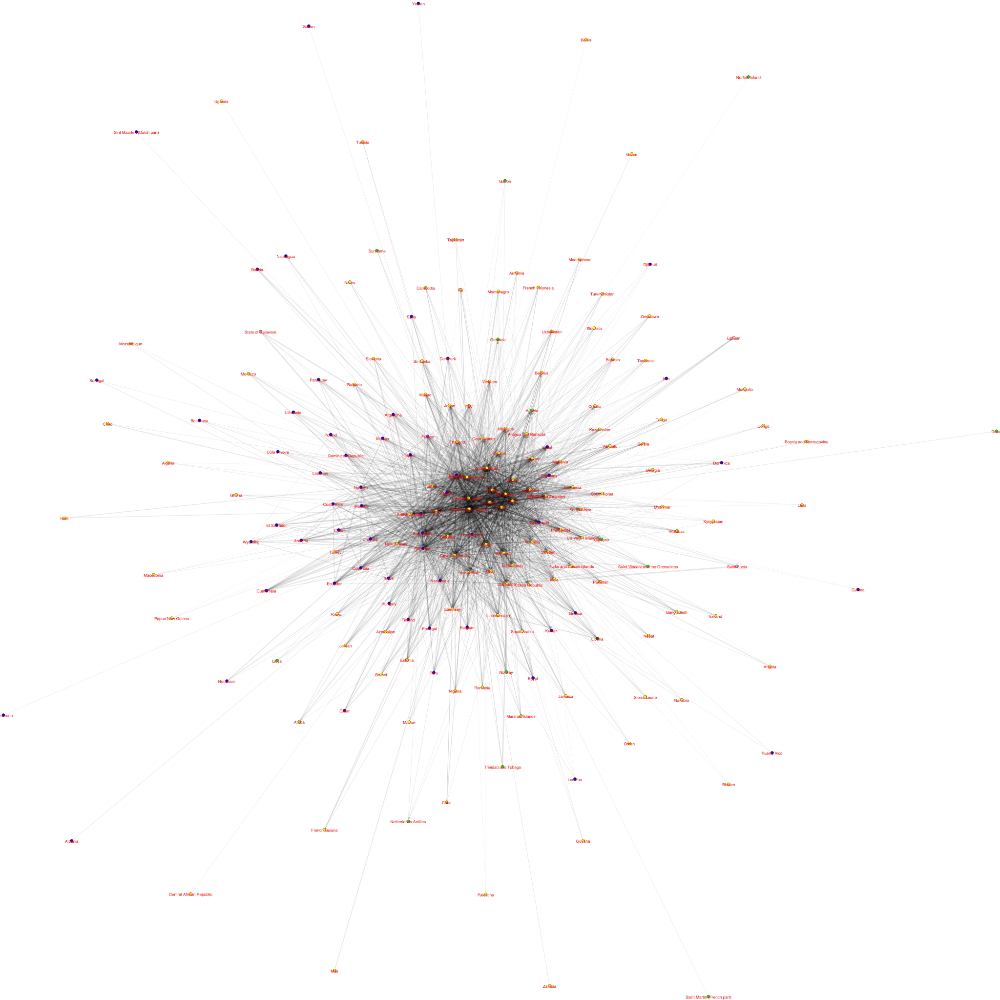

In [227]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_leading_eigenvector_ni.membership)):
    vertex_colors.append(colors[comm_leading_eigenvector_ni.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_ni.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_ni.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_ni,'directed_all_jur_images/communities_leading_eigenvector.png', vertex_label = g_ni.vs['name'] , **visual_style)

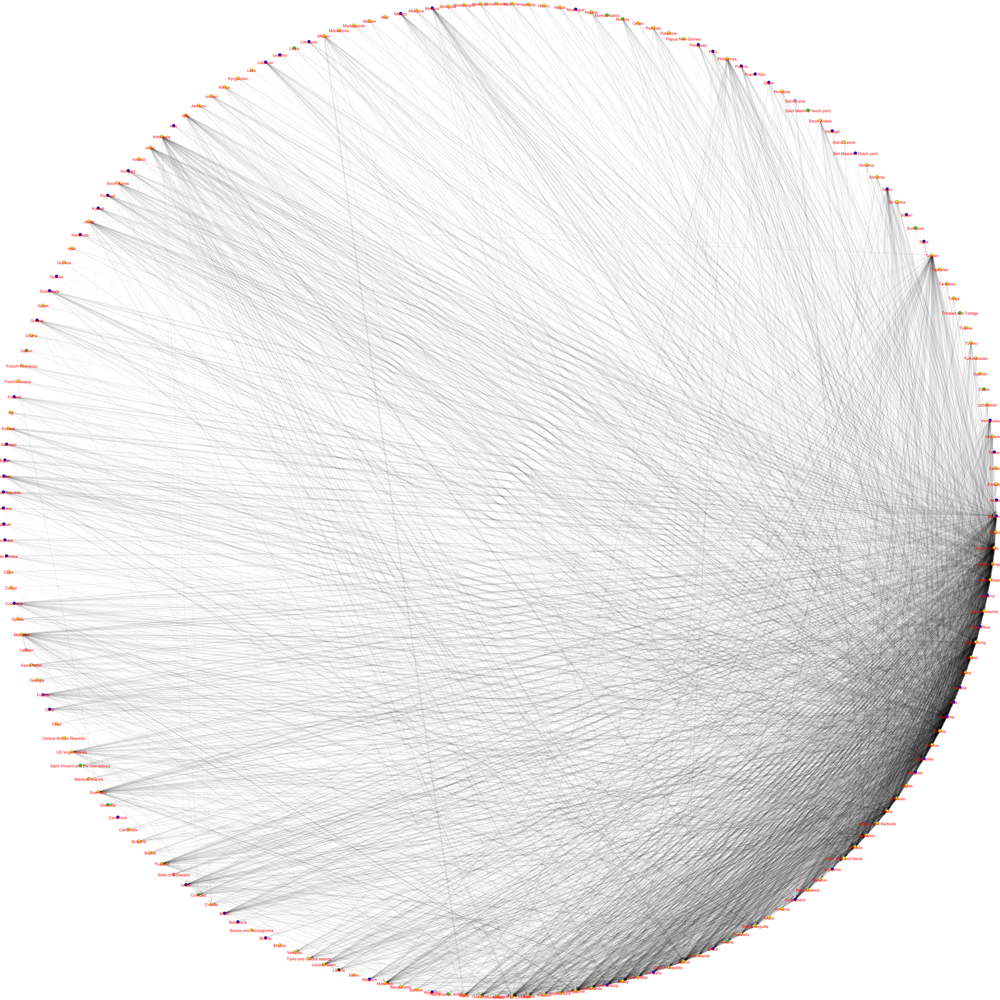

In [228]:
# Set the layout
my_layout = g_ni.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_ni,'directed_all_jur_images/leading_vector_circular.png', vertex_label = g_ni.vs['name'] , **visual_style)

In [229]:
for i in range(len(comm_leading_eigenvector_ni.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_leading_eigenvector_ni.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_leading_eigenvector_ni.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_leading_eigenvector_ni.subgraphs()[i],'directed_all_jur_images/leading_eigenvector_subgraph' + str(i) + '.png' ,vertex_label = comm_leading_eigenvector_ni.subgraphs()[i].vs['name'],**visual_style  )
    

### Spinglass Community Detection

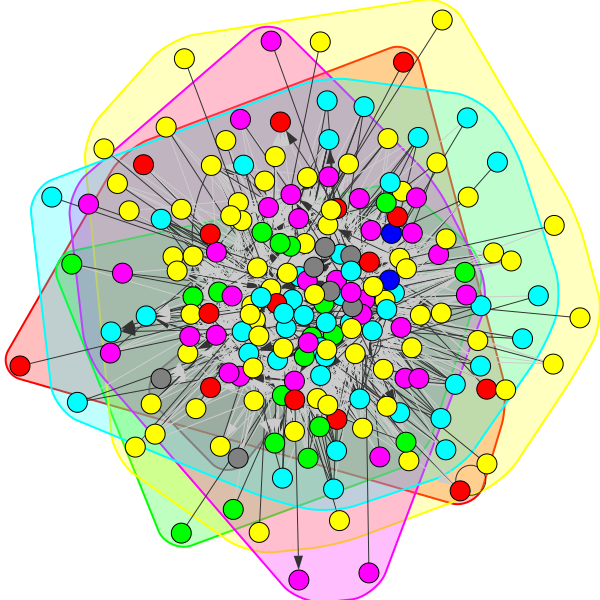

In [230]:
comm_spinglass_ni = g_ni.community_spinglass(weights = 'weight')

ig.plot(comm_spinglass_ni, mark_groups = True, layout="drl")

In [231]:
modularity = g_ni.modularity(comm_spinglass_ni, weights='weight')
print(modularity)

0.0542428665050368


In [232]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_spinglass_ni))
print('average degree: ', get_avg_degree(comm_spinglass_ni))
print('transitivity: ', get_transitivity(comm_spinglass_ni))
print('diameter: ', get_diameter(comm_spinglass_ni))

average weighted degree:  [118.26666666666667, 1465.157894736842, 230.0, 1063.6712328767123, 2070.9411764705883, 2485.8444444444444, 465.7142857142857]
average degree:  [2.4, 4.947368421052632, 1.0, 3.452054794520548, 3.823529411764706, 15.555555555555555, 2.0]
transitivity:  [0.1111111111111111, 0.39, nan, 0.058233581365253966, 0.1836734693877551, 0.5990792250143872, 0.0]
diameter:  [3, 3, 1, 3, 4, 4, 1]


In [233]:
df_spinglass_ni = pd.DataFrame({'name': list(g_ni.vs['name']), 'community':comm_spinglass_ni.membership } )
df_spinglass_ni

,name,community
0,Albania,1
1,Bahamas,1
2,Algeria,5
3,British Virgin Islands,3
4,United Kingdom,5
...,...,...
190,Venezuela,4
191,Vietnam,5
192,Yemen,4
193,Zambia,3


In [234]:
df_spinglass_ni.describe()

,community
count,195.000000
mean,3.307692
std,1.559042
min,0.000000
25%,3.000000
50%,3.000000
75%,5.000000
max,6.000000


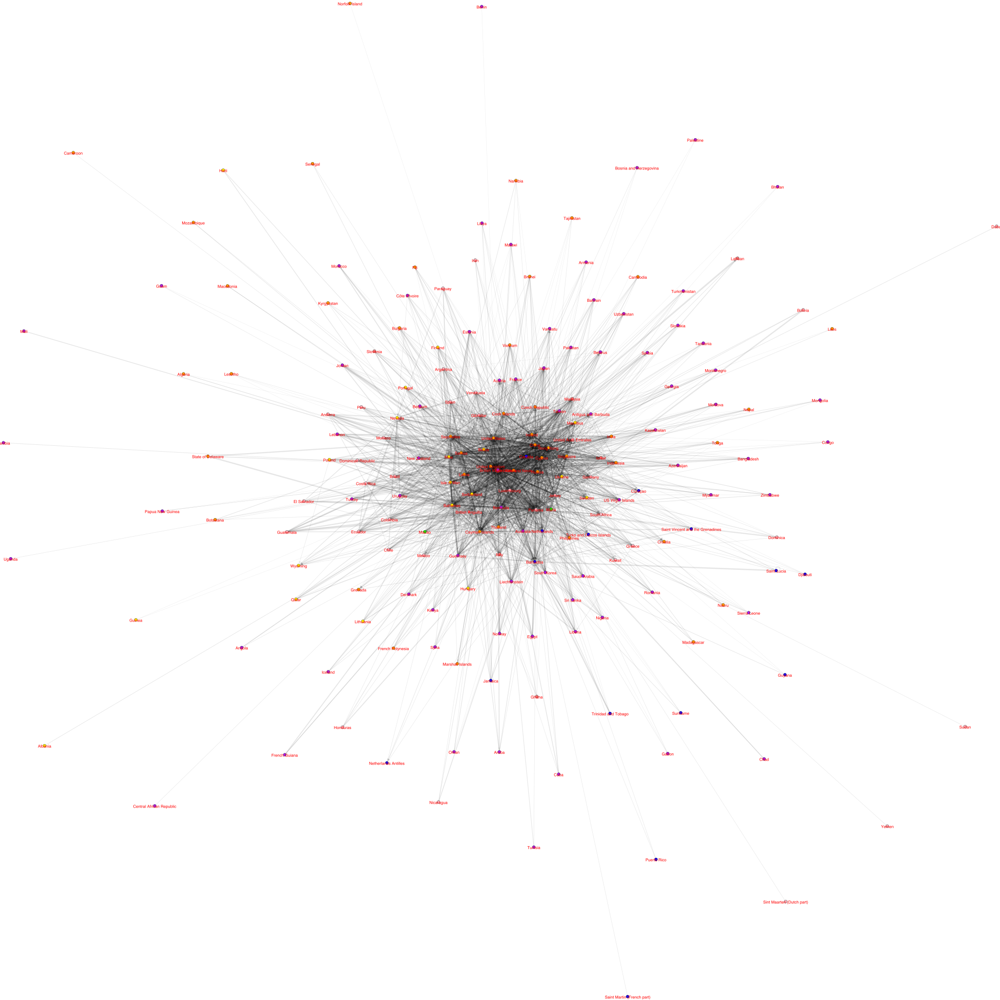

In [235]:
##plot community
visual_style = {}

vertex_colors = []

for i in range(len(comm_spinglass_ni.membership)):
    vertex_colors.append(colors[comm_spinglass_ni.membership[i]])
    
# Set bbox and margin
visual_style["bbox"] = (5000,5000)
visual_style["margin"] = 17

# Set vertex colours
visual_style["vertex_color"] = vertex_colors

# Set edge width
visual_style["edge_width"] = np.log(g_ni.es['weight']) + 1

# Set edge color
visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# Set vertex size
visual_style["vertex_size"] = 15

# Set vertex label size
visual_style["vertex_label_size"] = 20

# Set vertex label color
visual_style["vertex_label_color"] = 'red'

# Don't curve the edges
visual_style["edge_curved"] = False

# Set the layout
my_layout = g_ni.layout_fruchterman_reingold()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_ni,'directed_all_jur_images/communities_spinglass.png', vertex_label = g_ni.vs['name'] , **visual_style)

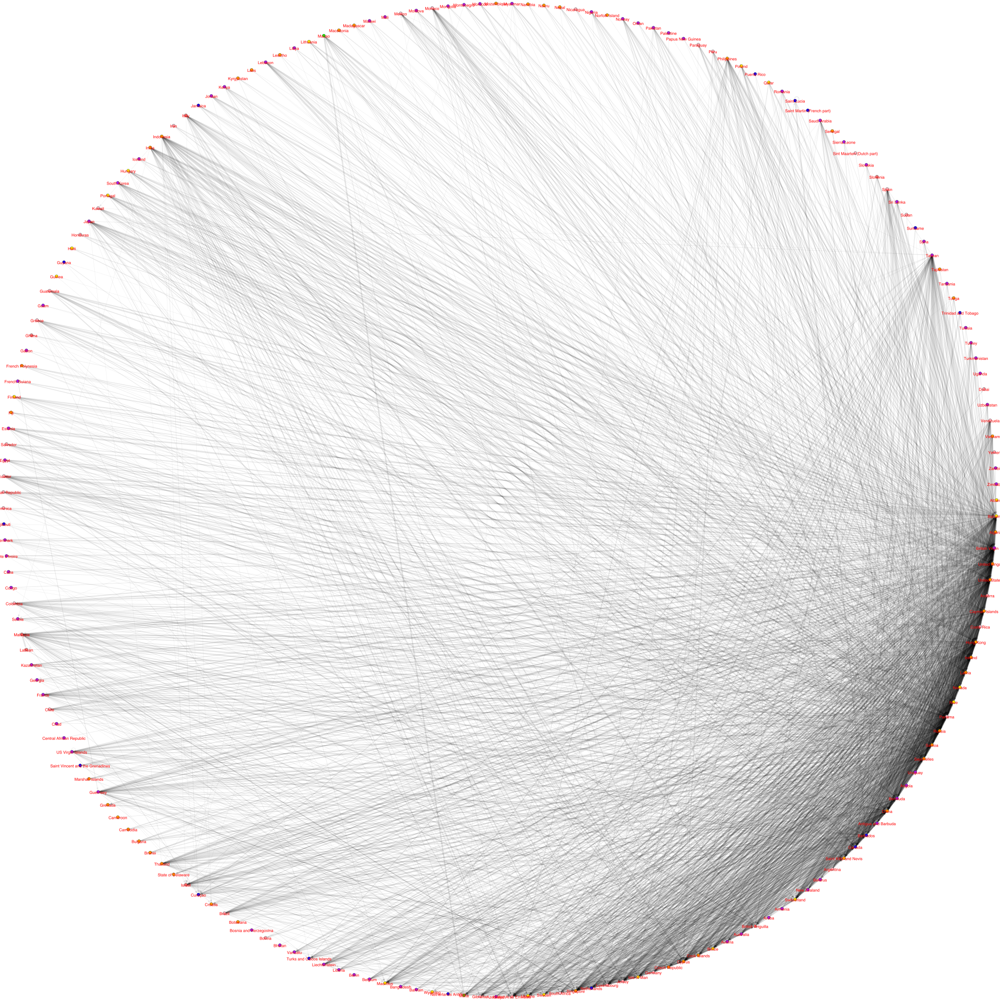

In [236]:
# Set the layout
my_layout = g_ni.layout_circle()
visual_style["layout"] = my_layout

# Plot the graph
ig.plot(g_ni,'directed_all_jur_images/spinglass_circular.png', vertex_label = g_ni.vs['name'] , **visual_style)

In [237]:
for i in range(len(comm_spinglass_ni.subgraphs())):
    
    visual_style["bbox"] = (2000,2000)
    visual_style["margin"] = 17
    
    # Set vertex colours
    visual_style["vertex_color"] = 'green'

    # Set edge width
    visual_style["edge_width"] = np.log(comm_spinglass_ni.subgraphs()[i].es['weight']) + 1
    # Set the layout
    my_layout = comm_spinglass_ni.subgraphs()[i].layout_fruchterman_reingold()
    visual_style["layout"] = my_layout

    ig.plot(comm_spinglass_ni.subgraphs()[i],'directed_all_jur_images/spinglass_subgraph' + str(i) + '.png' ,vertex_label = comm_spinglass_ni.subgraphs()[i].vs['name'],**visual_style  )
    

### Walktrap Community Detection

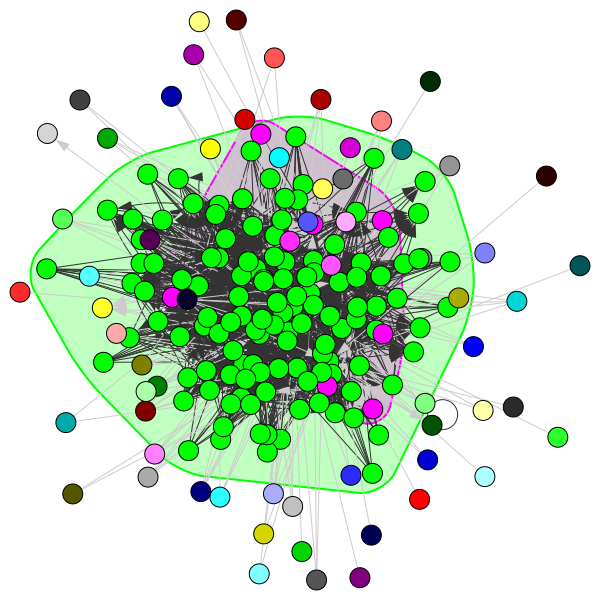

In [238]:
walktrap_ni = g_ni.community_walktrap(weights = 'weight', steps = 2)

comm_walktrap_ni = walktrap_ni.as_clustering()

ig.plot(comm_walktrap_ni, mark_groups = True, layout="drl")

In [239]:
modularity = g_ni.modularity(comm_walktrap_ni, weights='weight')
print(modularity)

0.002879845289073743


In [240]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_walktrap_ni))
print('average degree: ', get_avg_degree(comm_walktrap_ni))
print('transitivity: ', get_transitivity(comm_walktrap_ni))
print('diameter: ', get_diameter(comm_walktrap_ni))

average weighted degree:  [0.0, 8642.008064516129, 0.0, 0.0, 54.285714285714285, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 16.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
average degree:  [0.0, 37.903225806451616, 0.0, 0.0, 1.7142857142857142, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
transitivity:  [nan, 0.4614273777519436, nan, nan, 0.0, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,

In [241]:
df_walktrap_ni = pd.DataFrame({'name': list(g_ni.vs['name']), 'community':comm_walktrap_ni.membership } )
df_walktrap_ni

,name,community
0,Albania,0
1,Bahamas,1
2,Algeria,2
3,British Virgin Islands,1
4,United Kingdom,1
...,...,...
190,Venezuela,1
191,Vietnam,1
192,Yemen,63
193,Zambia,64


In [242]:
df_walktrap_ni.describe()

,community
count,195.000000
mean,11.753846
std,18.576144
min,0.000000
25%,1.000000
50%,1.000000
75%,16.500000
max,65.000000


In [243]:
# ##plot community
# visual_style = {}

# vertex_colors = []

# for i in range(len(comm_walktrap_ni.membership)):
#     vertex_colors.append(colors[comm_walktrap_ni.membership[i]])
    
# # Set bbox and margin
# visual_style["bbox"] = (5000,5000)
# visual_style["margin"] = 17

# # Set vertex colours
# visual_style["vertex_color"] = vertex_colors

# # Set edge width
# visual_style["edge_width"] = np.log(g_ni.es['weight']) + 1

# # Set edge color
# visual_style["edge_color"] = "rgba(1,1,1,0.1)" 

# # Set vertex size
# visual_style["vertex_size"] = 15

# # Set vertex label size
# visual_style["vertex_label_size"] = 20

# # Set vertex label color
# visual_style["vertex_label_color"] = 'red'

# # Don't curve the edges
# visual_style["edge_curved"] = False

# # Set the layout
# my_layout = g_ni.layout_fruchterman_reingold()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_ni,'directed_all_jur_images/communities_walktrap.png', vertex_label = g_ni.vs['name'] , **visual_style)

In [244]:
# # Set the layout
# my_layout = g_ni.layout_circle()
# visual_style["layout"] = my_layout

# # Plot the graph
# ig.plot(g_ni,'directed_all_jur_images/walktrap_circular.png', vertex_label = g_ni.vs['name'] , **visual_style)

In [245]:
# for i in range(len(comm_walktrap_ni.subgraphs())):
    
#     visual_style["bbox"] = (2000,2000)
#     visual_style["margin"] = 17
    
#     # Set vertex colours
#     visual_style["vertex_color"] = 'green'

#     # Set edge width
#     visual_style["edge_width"] = np.log(comm_walktrap_ni.subgraphs()[i].es['weight']) + 1
#     # Set the layout
#     my_layout = comm_walktrap_ni.subgraphs()[i].layout_fruchterman_reingold()
#     visual_style["layout"] = my_layout

#     ig.plot(comm_walktrap_ni.subgraphs()[i],'directed_all_jur_images/walktrap_subgraph' + str(i) + '.png' ,vertex_label = comm_walktrap_ni.subgraphs()[i].vs['name'],**visual_style  )
    

### Infomap Community Detection

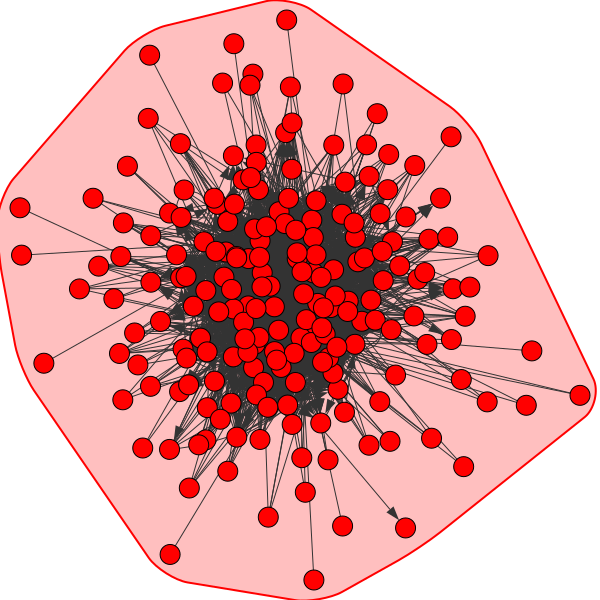

In [246]:
comm_infomap_ni = g_ni.community_infomap(edge_weights = 'weight')

ig.plot(comm_infomap_ni, mark_groups = True, layout="drl")

In [247]:
modularity = g_ni.modularity(comm_infomap_ni, weights='weight')
print(modularity)

0.0


In [248]:
#get metrics for each community

print('average weighted degree: ', get_avg_weighted_degree(comm_infomap_ni))
print('average degree: ', get_avg_degree(comm_infomap_ni))
print('transitivity: ', get_transitivity(comm_infomap_ni))
print('diameter: ', get_diameter(comm_infomap_ni))

average weighted degree:  [5595.635897435897]
average degree:  [28.256410256410255]
transitivity:  [0.3829243625911535]
diameter:  [4]


In [249]:
df_infomap_ni = pd.DataFrame({'name': list(g_ni.vs['name']), 'community':comm_infomap_ni.membership } )
df_infomap_ni

,name,community
0,Albania,0
1,Bahamas,0
2,Algeria,0
3,British Virgin Islands,0
4,United Kingdom,0
...,...,...
190,Venezuela,0
191,Vietnam,0
192,Yemen,0
193,Zambia,0
